**Check GPU RAM for the current Colab Runtime**


In [3]:
# memory footprint support libraries/code
!ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
!pip install -q gputil
import psutil
import humanize
import os
import GPUtil as GPU
GPUs = GPU.getGPUs()
# XXX: only one GPU on Colab and isn’t guaranteed
gpu = GPUs[0]
def printm():
    process = psutil.Process(os.getpid())
    print("Gen RAM Free: " + humanize.naturalsize( psutil.virtual_memory().available ), " | Proc size: " + humanize.naturalsize( process.memory_info().rss))
    print("GPU RAM Free: {0:.0f}MB | Used: {1:.0f}MB | Util {2:3.0f}% | Total {3:.0f}MB".format(gpu.memoryFree, gpu.memoryUsed, gpu.memoryUtil*100, gpu.memoryTotal))
printm() 

Gen RAM Free: 26.3 GB  | Proc size: 152.8 MB
GPU RAM Free: 16280MB | Used: 0MB | Util   0% | Total 16280MB


**Import the Relvant Libraries**

In [4]:
try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 2.x
    # Load the TensorBoard notebook extension
    %load_ext tensorboard   
except Exception:
  pass

import tensorflow as tf
from tensorflow import keras
from tensorboard.plugins.hparams import api as hp

In [5]:
from sklearn.preprocessing import LabelBinarizer, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import imgaug.augmenters as iaa
import matplotlib.pyplot as plt
from imutils import paths
import seaborn as sns
import imgaug as aug
import pandas as pd
import numpy as np
import datetime
import h5py
import cv2
import os

In [6]:
# Helper Functions
def show_image(img):
    '''
    Quick display of image in grayscale 
    '''
    if type(img) == 'str':
        img = plt.imread(img)
    plt.imshow(img, cmap = 'gray')
    plt.title('Example X-Ray scan')
    plt.grid(False)
    plt.axis('off')
    plt.show()

In [7]:

!git clone https://github.com/nazmul0087/Covid19Detection

Cloning into 'Covid19Detection'...
remote: Enumerating objects: 2172, done.
remote: Counting objects: 100% (16/16), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 2172 (delta 6), reused 14 (delta 4), pack-reused 2156
Receiving objects: 100% (2172/2172), 1011.37 MiB | 50.57 MiB/s, done.
Resolving deltas: 100% (6/6), done.
Checking out files: 100% (2165/2165), done.


Clone dataset repository from Github


In [8]:
#!git clone https://github.com/nazmul0087/Covid19Detection
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


Read Nomral vs Covid-19 images and one-hot encod the labels


[INFO] loading images...

[INFO] creating a DataFrame...
                                               image     label
0  /content/drive/MyDrive/Thesis_covid 19/COVID-1...  0-NORMAL
1  /content/drive/MyDrive/Thesis_covid 19/COVID-1...   1-COVID
2  /content/drive/MyDrive/Thesis_covid 19/COVID-1...   1-COVID
3  /content/drive/MyDrive/Thesis_covid 19/COVID-1...   1-COVID
4  /content/drive/MyDrive/Thesis_covid 19/COVID-1...  0-NORMAL
5  /content/drive/MyDrive/Thesis_covid 19/COVID-1...   1-COVID
6  /content/drive/MyDrive/Thesis_covid 19/COVID-1...   1-COVID
7  /content/drive/MyDrive/Thesis_covid 19/COVID-1...  0-NORMAL
8  /content/drive/MyDrive/Thesis_covid 19/COVID-1...   1-COVID
9  /content/drive/MyDrive/Thesis_covid 19/COVID-1...  0-NORMAL


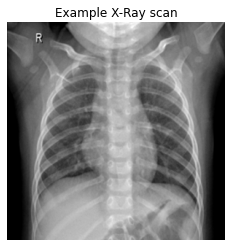


[INFO] one-hot encoding...
	Example scan label: 0-NORMAL
	One-hot encoded label:  0

[INFO] updating data DataFrame...
                                               image  label
0  /content/drive/MyDrive/Thesis_covid 19/COVID-1...      0
1  /content/drive/MyDrive/Thesis_covid 19/COVID-1...      1
2  /content/drive/MyDrive/Thesis_covid 19/COVID-1...      1
3  /content/drive/MyDrive/Thesis_covid 19/COVID-1...      1
4  /content/drive/MyDrive/Thesis_covid 19/COVID-1...      0
5  /content/drive/MyDrive/Thesis_covid 19/COVID-1...      1
6  /content/drive/MyDrive/Thesis_covid 19/COVID-1...      1
7  /content/drive/MyDrive/Thesis_covid 19/COVID-1...      0
8  /content/drive/MyDrive/Thesis_covid 19/COVID-1...      1
9  /content/drive/MyDrive/Thesis_covid 19/COVID-1...      0


In [9]:
dataset_path="/content/drive/MyDrive/Thesis_covid 19/COVID-19_Radiography_Dataset_V1_1000"
#dataset_path = '/content/Covid19Detection/DATASET'

# Read all files from path
print("[INFO] loading images...")
imagePaths = list(paths.list_images(dataset_path))

data = []

# select number of classes to be loaded for Normal, Bacterial Pneumonia and Viral Pneumonia patients 
num_normal = 1000

n = 0 #initialize all 3 counters to limit the number of images loaded 
for imagePath in imagePaths:
    # extract the class label from the filename
    label = imagePath.split(os.path.sep)[-2]

    if label == '0-NORMAL' and n < num_normal:
      data.append((imagePath,label))
      n += 1

    elif label == '1-COVID':
      data.append((imagePath,label))

print('\n[INFO] creating a DataFrame...')
# Get a pandas dataframe from the data we have in our list 
data = pd.DataFrame(data, columns=['image', 'label'],index=None)

# Shuffle the data 
data = data.sample(frac=1.).reset_index(drop=True)
print(data.head(10))

tmp_img = plt.imread(data["image"][0])
show_image(tmp_img)
del tmp_img

# perform one-hot encoding on the labels
print('\n[INFO] one-hot encoding...')
print('\tExample scan label:', data["label"][0])

data["label"] = LabelEncoder().fit_transform(data["label"])
print('\tOne-hot encoded label: ',data["label"][0])
print('\n[INFO] updating data DataFrame...')
print(data.head(10))

Visualise example X-ray scans


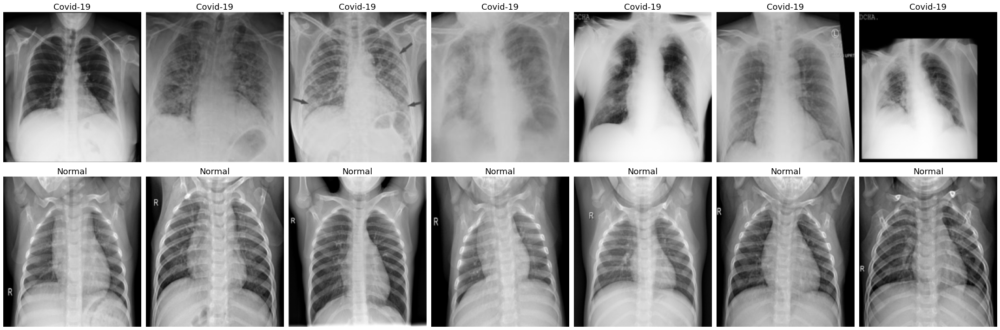

In [10]:
# select the number of sampels to be plotted for each class
sample_num = 7
normal_samples = (data[data['label']==0]['image'].iloc[30:30+sample_num]).tolist()
covid_samples = (data[data['label']==1]['image'].iloc[5:5+sample_num]).tolist()

samples = covid_samples + normal_samples
del covid_samples, normal_samples

color = 'black'

# Plot the data 
f, ax = plt.subplots(2,sample_num, figsize=(30,10))
for i in range(sample_num*2):
    img = cv2.imread(samples[i])
    img = cv2.resize(img, (224, 224))
    if i<sample_num:
        ax[0, i%sample_num].imshow(img, cmap='gray')
        ax[0, i%sample_num].set_title("Covid-19", fontsize=18, color = color)
    else:
        ax[1, i%sample_num].imshow(img, cmap='gray')
        ax[1, i%sample_num].set_title("Normal", fontsize=18, color = color)

    ax[i//sample_num, i%sample_num].axis('off')
    ax[i//sample_num, i%sample_num].set_aspect('auto')

plt.tight_layout()
plt.show()


Select training, validation and testing data split

In [11]:
train_data, test_data = train_test_split(data, test_size=0.20,shuffle=True,random_state=12)
train_data, valid_data = train_test_split(train_data, test_size=0.20, random_state=12)

print('\nNumber of training pairs: ', len(train_data))
print('Number of validation pairs: ', len(valid_data))
print('Number of testing pairs: ', len(test_data))


Number of training pairs:  1280
Number of validation pairs:  320
Number of testing pairs:  400


In [12]:
data['label'].value_counts()

1    1000
0    1000
Name: label, dtype: int64

	----- Entire Dataset ------
		 [1000 1000]

-- Train Set -- -- Validation Set -- -- Test Set --
   [644 636] 	      [165 155] 	         [201 199] 




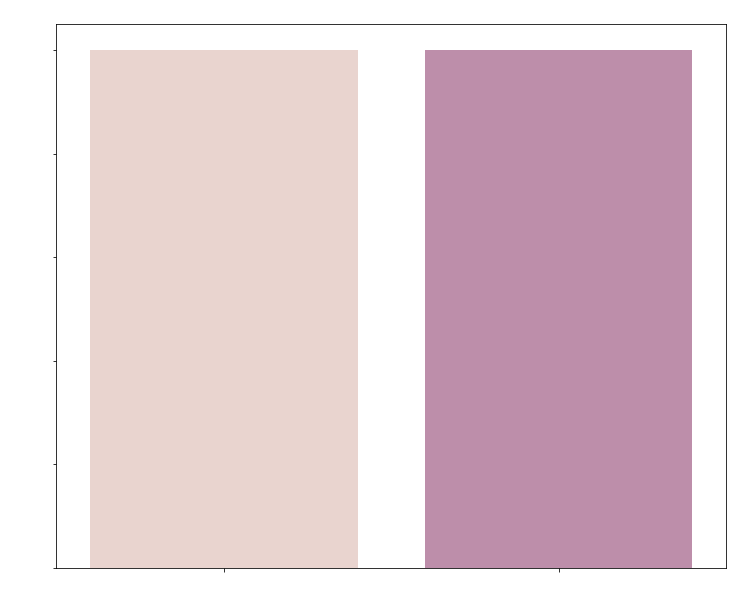

In [13]:
# Get the counts for each class
cases_count = data['label'].value_counts()
print('\t----- Entire Dataset ------')
print('\t\t', cases_count.ravel())

cases_count_tr = train_data['label'].value_counts()
cases_count_val = valid_data['label'].value_counts()
cases_count_tst = test_data['label'].value_counts()
print('\n-- Train Set -- -- Validation Set -- -- Test Set --')
print('  ', cases_count_tr.ravel(),'\t     ',cases_count_val.ravel(), '\t        ', cases_count_tst.ravel(), '\n\n')

# Plot the results 
plt.figure(figsize=(12,10))
sns.barplot(x=cases_count.index, y= cases_count.values, palette=sns.cubehelix_palette(4, start=2.5, rot=0.6))
plt.title('Frequency of Each Class in the Dataset', fontsize=14, color='w') #remove color = white if not in dark mode!
plt.xlabel('Case type', fontsize=12, color='w')
plt.ylabel('Count', fontsize=12, color='w')
plt.xticks(range(len(cases_count.index)), ['Normal (0)', 'Covid-19 (1)'], color='w')
plt.yticks(color='w')
plt.show()

In [14]:
def get_arrays(df):
    print('[INFO] retreiving images from path...')
    images, labels = [], []

    img_paths = df.iloc[:,0].values # extract image paths from DataFrame
    labels_ = df.iloc[:,1].values # extract labels from DataFrame

    for i,path in enumerate(img_paths):
        # load the image, swap color channels, and resize it to be a fixed 224x224 pixels while ignoring aspect ratio
        image = cv2.imread(path)

        # check if it's grayscale
        if image.shape[2]==1:
            print(image.shape[2])
            image = np.dstack([image, image, image])

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, (512, 512))
        image = image / 255.0 # Normalize images to range [0,1]
        # print('pre: ', labels_[i])
        encoded_label = tf.keras.utils.to_categorical(labels_[i], num_classes=2)
        # print('encoded: ',encoded_label )
        images.append(image)
        labels.append(encoded_label)

    return np.array(images), np.array(labels)

In [15]:
trainX, trainY = get_arrays(train_data)
validX, validY = get_arrays(valid_data)
testX, testY = get_arrays(test_data)

[INFO] retreiving images from path...
[INFO] retreiving images from path...
[INFO] retreiving images from path...


In [16]:

# calculating class weights from trainset for class imabalance
print('[INFO] calculating class weights...')
print(cases_count_tr)
covid_pneumonia_count = cases_count_tr.ravel()[1]
normal_count = cases_count_tr.ravel()[0]

class_weights = {0: 1.0, 1: normal_count/covid_pneumonia_count} 

print('\nclass weights: ', class_weights) 

[INFO] calculating class weights...
1    644
0    636
Name: label, dtype: int64

class weights:  {0: 1.0, 1: 1.0125786163522013}


Build our model on top of pre-trained Xception model


In [17]:
def build_model(baseModel):

      # Make all pre-trained layers non-trainable 
      for layer in baseModel.layers[:-3]:
          layer.trainable = False

      # Add trainable fully-connected (FC) layers for predictions
      newModel = baseModel.output
      newModel = tf.keras.layers.AveragePooling2D(pool_size=(4, 4),name="avg_f1")(newModel)
      newModel = tf.keras.layers.Flatten(name="flatten")(newModel)
      #newModel = tf.keras.layers.Dense(64, activation="relu", name="dense_f1")(newModel)
      #newModel = tf.keras.layers.Dropout(0.5, name="dpoutf1")(newModel)
      newModel = tf.keras.layers.Dense(2, activation="sigmoid", name='dense_f2')(newModel)

      # Stack the FC layers on top of Xception model
      model = tf.keras.models.Model(inputs=baseModel.input, outputs=newModel, name='Xception_Covid19_Detector')

      return model

     

baseModel = classifier = tf.keras.applications.Xception(weights="imagenet", include_top=False,
            input_tensor = tf.keras.layers.Input(shape=(512,512,3)))
model = build_model(baseModel)
model.summary()

model.compile(loss=tf.keras.losses.binary_crossentropy, optimizer='adam', metrics=["accuracy"])

# initialize the training data augmentation object
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    # rescale= 1 / 255.0,
    rotation_range=15,
    zoom_range=0.05,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.05,
    fill_mode="nearest")

  
valid_datagen = tf.keras.preprocessing.image.ImageDataGenerator()


early_stopping = tf.keras.callbacks.EarlyStopping(
monitor='val_accuracy', 
verbose=1,
patience=5,
mode='max',
restore_best_weights=True
)

reduce_on_plateau = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.25, patience=5, verbose=0, 
                                                                    mode='auto', min_delta=0.00001, cooldown=0, min_lr=0)

model_checkpoint = tf.keras.callbacks.ModelCheckpoint('xception_weights.h5', 
                                                      monitor='val_accuracy', verbose=0, save_best_only=True, 
                                                      save_weights_only=True, mode='max')


callbacks = [early_stopping, reduce_on_plateau, model_checkpoint]

batch_size = 15
epochs = 100
results = model.fit(
    train_datagen.flow(trainX, trainY, batch_size=batch_size),
    steps_per_epoch=len(trainX) // batch_size,
    validation_data=valid_datagen.flow(validX, validY, batch_size=batch_size),
    validation_steps=len(validX) // batch_size,
    class_weight = class_weights,
    epochs=epochs,
    callbacks=callbacks
)

83689472/83683744 [==============================] - 1s 0us/step
Model: "Xception_Covid19_Detector"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 512, 512, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 255, 255, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 255, 255, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 255, 255, 32) 0           block1_conv1_bn[0][0]            
_________

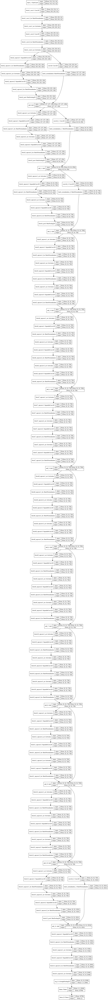

In [18]:

from keras.utils.vis_utils import plot_model


plot_model(model, to_file='xception_model_plot.png', show_shapes=True, show_layer_names=True)

Analyse Results from the Test Set

In [19]:
# Make predictions on the testing set
print("[INFO] evaluating network...")
predIdxs = model.predict(testX, batch_size=batch_size)
print('Number of test scans: ', len(testX))
print('Predicted class probabilities:')
print()

for n in range(len(predIdxs)):
    my_formatted_list = ['%.2f' % elem for elem in predIdxs[n]]
    print(f'{n}:  ', *my_formatted_list)

# Find the predicted labels 
predIdxs = np.argmax(predIdxs, axis=1)
print('\nPredicted outcome (Covid=1, Normal=0):')
print(predIdxs)
print('Ground-truth outcome:')
# print(testY)
trueIdxs = np.argmax(testY, axis=1)
print(trueIdxs)


[INFO] evaluating network...
Number of test scans:  400
Predicted class probabilities:

0:   1.00 0.00
1:   1.00 0.00
2:   0.00 1.00
3:   0.42 0.48
4:   0.00 1.00
5:   0.00 1.00
6:   0.00 1.00
7:   0.00 1.00
8:   0.00 1.00
9:   0.21 0.75
10:   1.00 0.00
11:   1.00 0.00
12:   0.00 1.00
13:   0.00 1.00
14:   1.00 0.00
15:   1.00 0.00
16:   0.00 1.00
17:   0.00 1.00
18:   1.00 0.00
19:   0.00 1.00
20:   0.00 1.00
21:   0.00 1.00
22:   0.01 0.99
23:   0.00 1.00
24:   1.00 0.00
25:   1.00 0.00
26:   1.00 0.00
27:   0.00 1.00
28:   1.00 0.00
29:   0.00 1.00
30:   1.00 0.00
31:   1.00 0.00
32:   1.00 0.00
33:   0.00 1.00
34:   0.00 1.00
35:   0.00 1.00
36:   0.00 1.00
37:   1.00 0.00
38:   1.00 0.00
39:   1.00 0.00
40:   0.53 0.46
41:   0.00 1.00
42:   0.00 1.00
43:   0.90 0.10
44:   0.00 1.00
45:   1.00 0.00
46:   0.00 1.00
47:   0.00 1.00
48:   0.00 1.00
49:   0.03 0.96
50:   0.00 1.00
51:   1.00 0.00
52:   1.00 0.00
53:   1.00 0.00
54:   1.00 0.00
55:   0.07 0.93
56:   0.01 1.00
57:   0.00

In [20]:
import numpy as np
import tensorflow as tf
from tensorflow import keras

# Display
from IPython.display import Image, display
import matplotlib.pyplot as plt
import matplotlib.cm as cm



Loss/Accuracy Curve

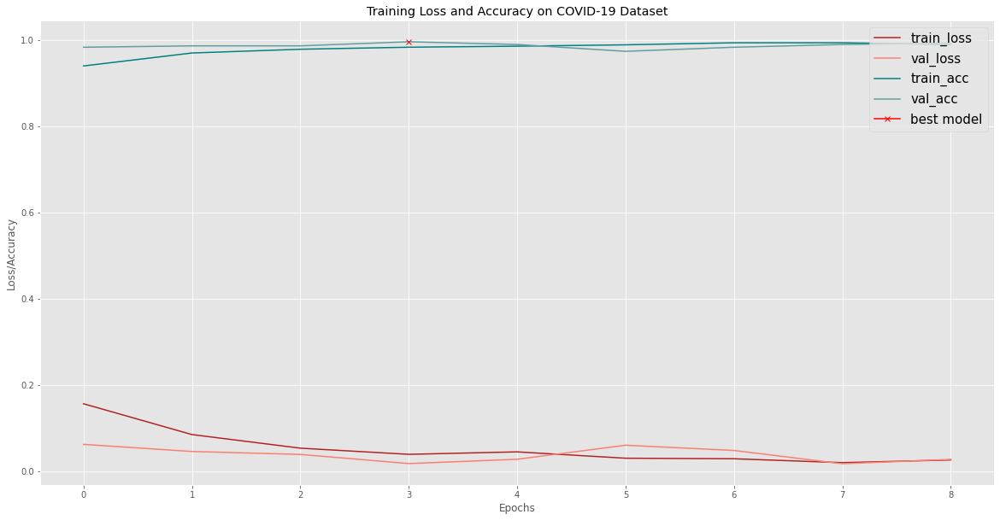

In [21]:
N = len(results.history["loss"])
plt.style.use("ggplot")
plt.figure(figsize = (20,10))
plt.plot(np.arange(0, N), results.history["loss"], label="train_loss", color = 'firebrick')
plt.plot(np.arange(0, N), results.history["val_loss"], label="val_loss", color = 'salmon')
plt.plot(np.arange(0, N), results.history["accuracy"], label="train_acc", color = 'teal')
plt.plot(np.arange(0, N), results.history["val_accuracy"], label="val_acc",color = 'cadetblue')
plt.plot( np.argmax(results.history["val_accuracy"]), np.max(results.history["val_accuracy"]), marker="x", color="r", label="best model")
plt.title("Training Loss and Accuracy on COVID-19 Dataset")
plt.xlabel("Epochs")
plt.ylabel("Loss/Accuracy")
plt.legend(loc="upper right", fontsize=15)
plt.savefig('loss_curve_xception.pdf', format='pdf')
plt.show()

compute the confusion matrix and and use it to derive the raw accuracy, sensitivity, and specificity

In [22]:
from matplotlib.font_manager import FontProperties

def plot_cm(labels, predictions):
    '''
    Plot the confusion matrix
    '''

    font = FontProperties()
    font.set_family('serif')
    font.set_name('Times New Roman')
    # font.set_style('italic')

    print(classification_report(labels, predictions, target_names=['Normal', 'Covid-19'], digits=3))

    cm = confusion_matrix(labels, predictions)
    print()

    plt.figure(figsize=(8,8))
    sns.heatmap(cm, annot=True, fmt="d", annot_kws={"size": 20})
    plt.yticks(fontsize=15)
    plt.xticks(fontsize=15)
    plt.title('Confusion Matrix',fontsize=30, fontweight='bold')
    plt.ylabel('Actual Label', fontsize=20)
    plt.xlabel('Predicted Label: Normal (0), Covid-19 (1)', fontsize=20)

loss :  0.192
accuracy :  0.978

              precision    recall  f1-score   support

      Normal      0.985     0.970     0.977       199
    Covid-19      0.971     0.985     0.978       201

    accuracy                          0.978       400
   macro avg      0.978     0.977     0.977       400
weighted avg      0.978     0.978     0.977       400




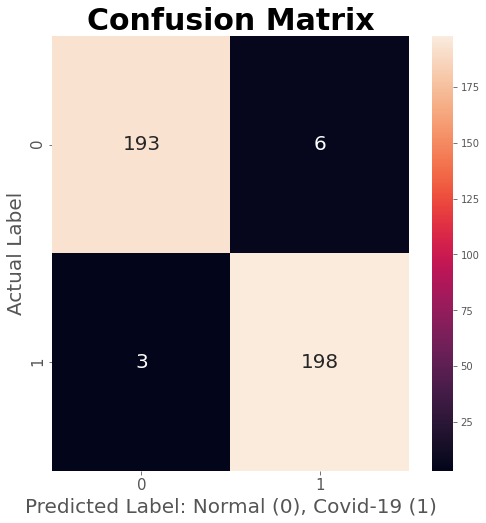

In [23]:


model.compile(loss=tf.keras.losses.categorical_crossentropy, optimizer='adam', metrics=["accuracy"])
predicted_metrics = model.evaluate(testX, testY,
                                  batch_size=batch_size, verbose=0)
for name, value in zip(model.metrics_names, predicted_metrics):
    print(name, ': ', "%.3f" % value)
print()

plot_cm(trueIdxs, predIdxs)
plt.savefig('confusion_matrix_xception.pdf', format='pdf')

In [24]:
import numpy as np
import tensorflow as tf
from tensorflow import keras

# Display
from IPython.display import Image, display
import matplotlib.pyplot as plt
import matplotlib.cm as cm

In [25]:
from tensorflow.keras.models import Model
import tensorflow as tf
import numpy as np
import cv2

class GradCAM:
    def __init__(self, model, classIdx, layerName=None):
        # store the model, the class index used to measure the class
        # activation map, and the layer to be used when visualizing
        # the class activation map
        self.model = model
        self.classIdx = classIdx
        self.layerName = layerName
        # if the layer name is None, attempt to automatically find
        # the target output layer
        if self.layerName is None:
            self.layerName = self.find_target_layer()

    def find_target_layer(self):
        # attempt to find the final convolutional layer in the network
        # by looping over the layers of the network in reverse order
        for layer in reversed(self.model.layers):
            # check to see if the layer has a 4D output
            if len(layer.output_shape) == 4:
                return layer.name
        # otherwise, we could not find a 4D layer so the GradCAM
        # algorithm cannot be applied
        raise ValueError("Could not find 4D layer. Cannot apply GradCAM.")


    def compute_heatmap(self, image, eps=1e-8):
        # construct our gradient model by supplying (1) the inputs
        # to our pre-trained model, (2) the output of the (presumably)
        # final 4D layer in the network, and (3) the output of the
        # softmax activations from the model
        gradModel = Model(
            inputs=[self.model.inputs],
            outputs=[self.model.get_layer(self.layerName).output, self.model.output])

        # record operations for automatic differentiation
        with tf.GradientTape() as tape:
            # cast the image tensor to a float-32 data type, pass the
            # image through the gradient model, and grab the loss
            # associated with the specific class index
            inputs = tf.cast(image, tf.float32)
            (convOutputs, predictions) = gradModel(inputs)
            
            loss = predictions[:, tf.argmax(predictions[0])]
    
        # use automatic differentiation to compute the gradients
        grads = tape.gradient(loss, convOutputs)

        # compute the guided gradients
        castConvOutputs = tf.cast(convOutputs > 0, "float32")
        castGrads = tf.cast(grads > 0, "float32")
        guidedGrads = castConvOutputs * castGrads * grads
        # the convolution and guided gradients have a batch dimension
        # (which we don't need) so let's grab the volume itself and
        # discard the batch
        convOutputs = convOutputs[0]
        guidedGrads = guidedGrads[0]

        # compute the average of the gradient values, and using them
        # as weights, compute the ponderation of the filters with
        # respect to the weights
        weights = tf.reduce_mean(guidedGrads, axis=(0, 1))
        cam = tf.reduce_sum(tf.multiply(weights, convOutputs), axis=-1)

        # grab the spatial dimensions of the input image and resize
        # the output class activation map to match the input image
        # dimensions
        (w, h) = (image.shape[2], image.shape[1])
        heatmap = cv2.resize(cam.numpy(), (w, h))
        # normalize the heatmap such that all values lie in the range
        # [0, 1], scale the resulting values to the range [0, 255],
        # and then convert to an unsigned 8-bit integer
        numer = heatmap - np.min(heatmap)
        denom = (heatmap.max() - heatmap.min()) + eps
        heatmap = numer / denom
        heatmap = (heatmap * 512).astype("uint8") # change to 255 from 512
        # return the resulting heatmap to the calling function
        return heatmap

    def overlay_heatmap(self, heatmap, image, alpha=0.5,
                        colormap=cv2.COLORMAP_VIRIDIS):
        # apply the supplied color map to the heatmap and then
        # overlay the heatmap on the input image
        heatmap = cv2.applyColorMap(heatmap, colormap)
        output = cv2.addWeighted(image, alpha, heatmap, 1 - alpha, 0)
        # return a 2-tuple of the color mapped heatmap and the output,
        # overlaid image
        return (heatmap, output)

In [26]:
for idx in range(len(model.layers)):
  print(model.get_layer(index = idx).name)

input_1
block1_conv1
block1_conv1_bn
block1_conv1_act
block1_conv2
block1_conv2_bn
block1_conv2_act
block2_sepconv1
block2_sepconv1_bn
block2_sepconv2_act
block2_sepconv2
block2_sepconv2_bn
conv2d
block2_pool
batch_normalization
add
block3_sepconv1_act
block3_sepconv1
block3_sepconv1_bn
block3_sepconv2_act
block3_sepconv2
block3_sepconv2_bn
conv2d_1
block3_pool
batch_normalization_1
add_1
block4_sepconv1_act
block4_sepconv1
block4_sepconv1_bn
block4_sepconv2_act
block4_sepconv2
block4_sepconv2_bn
conv2d_2
block4_pool
batch_normalization_2
add_2
block5_sepconv1_act
block5_sepconv1
block5_sepconv1_bn
block5_sepconv2_act
block5_sepconv2
block5_sepconv2_bn
block5_sepconv3_act
block5_sepconv3
block5_sepconv3_bn
add_3
block6_sepconv1_act
block6_sepconv1
block6_sepconv1_bn
block6_sepconv2_act
block6_sepconv2
block6_sepconv2_bn
block6_sepconv3_act
block6_sepconv3
block6_sepconv3_bn
add_4
block7_sepconv1_act
block7_sepconv1
block7_sepconv1_bn
block7_sepconv2_act
block7_sepconv2
block7_sepconv2_

In [27]:
!nvidia-smi

Sat Jul 10 16:13:33 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0    50W / 250W |   9757MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [28]:
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)






1
0
1
1


In [29]:
##For my reference chaning block only

# Image 1
icam1 = GradCAM(model, i1, 'block14_sepconv1') 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, 'block14_sepconv1') 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, "block14_sepconv1") 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, "block14_sepconv1")
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg')
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.4)



(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


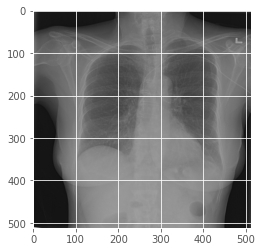

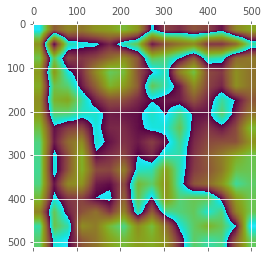

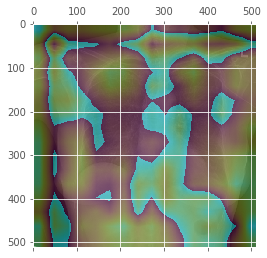

image2: Normal


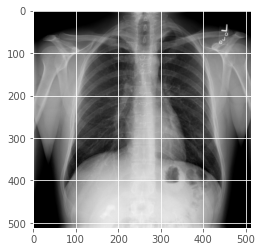

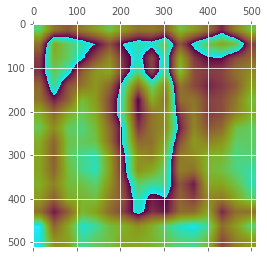

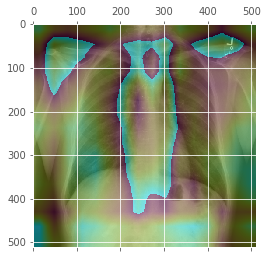

image2: Covid


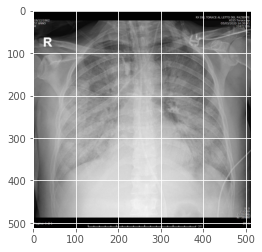

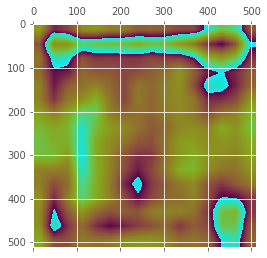

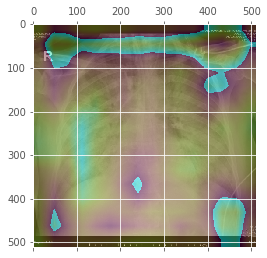

image2: Covid


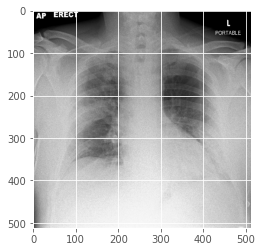

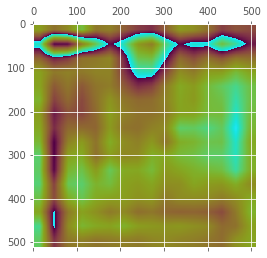

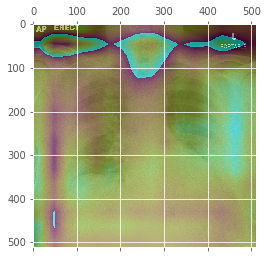

In [30]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [31]:
#declare a Variable named layer

Layer_to_examine='block13_sepconv1'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


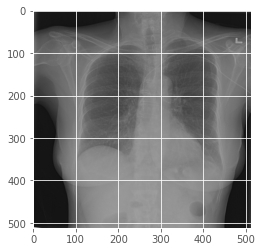

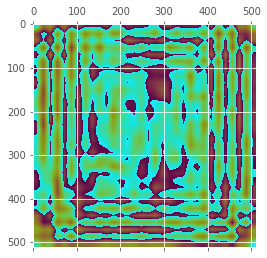

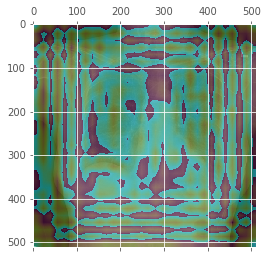

image2: Normal


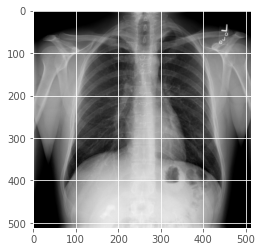

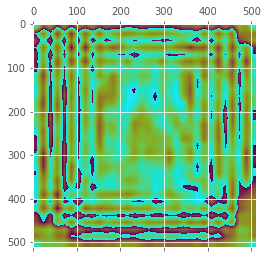

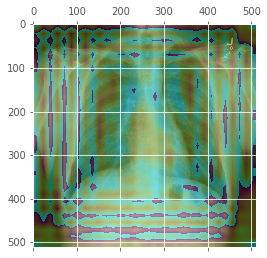

image2: Covid


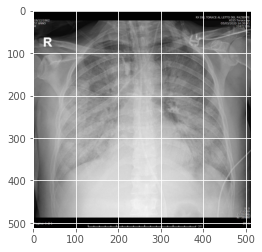

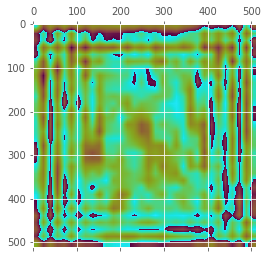

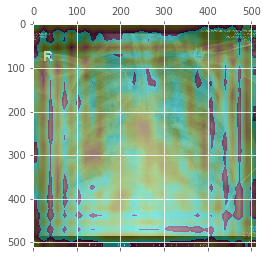

image2: Covid


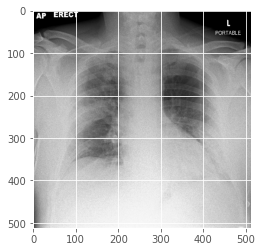

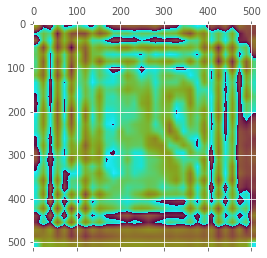

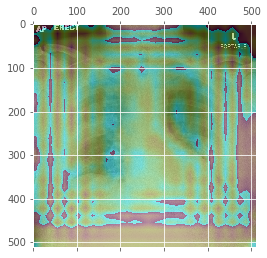

In [32]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [33]:
## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, 'block12_sepconv1') 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, 'block12_sepconv1') 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, 'block12_sepconv1') 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, 'block12_sepconv1') 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg')
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


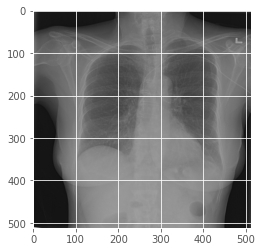

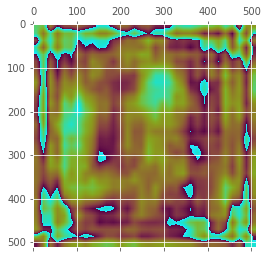

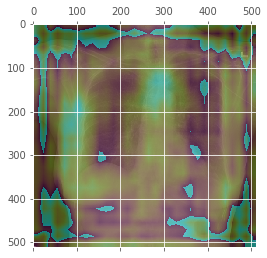

image2: Normal


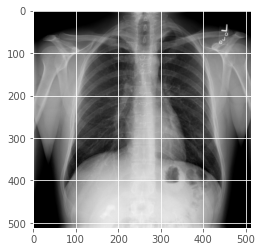

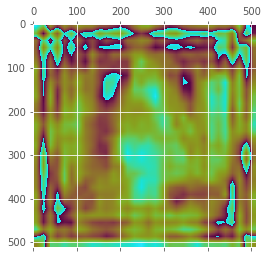

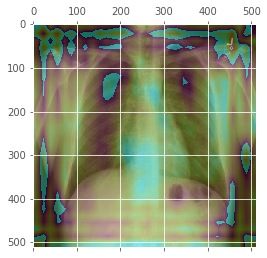

image2: Covid


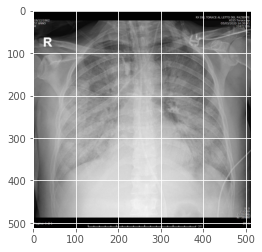

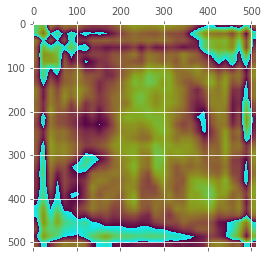

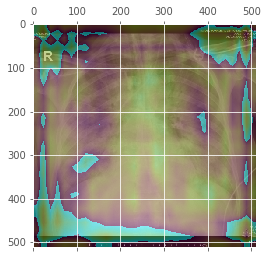

image2: Covid


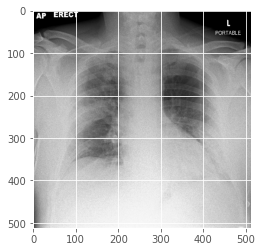

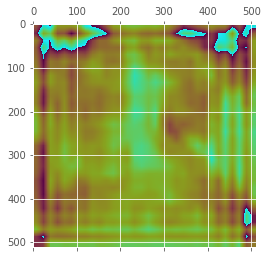

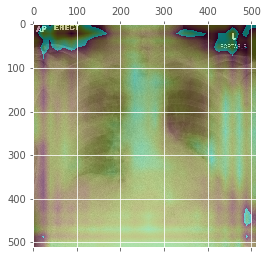

In [34]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [35]:
#declare a Variable named layer

Layer_to_examine='block11_sepconv1'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


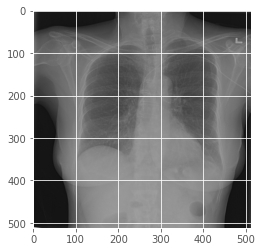

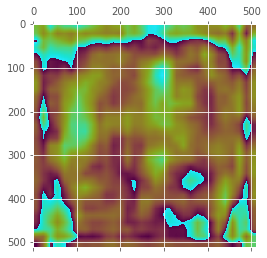

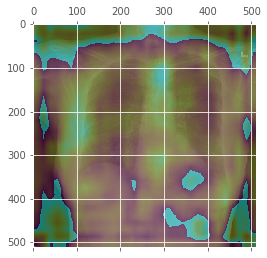

image2: Normal


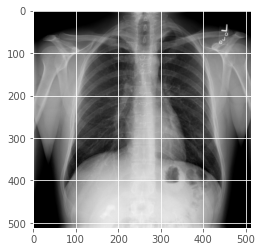

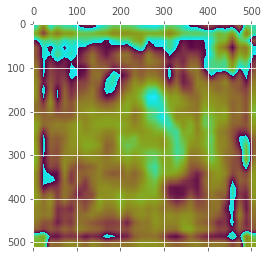

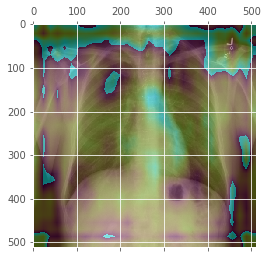

image2: Covid


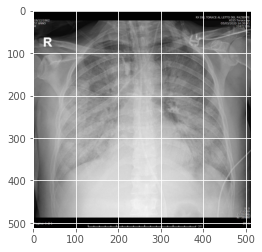

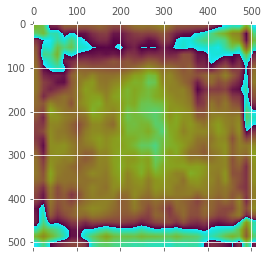

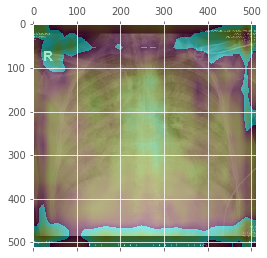

image2: Covid


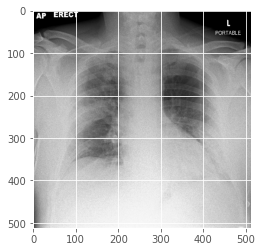

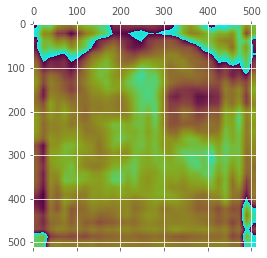

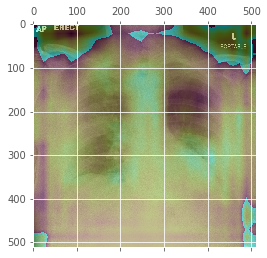

In [36]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [37]:
## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, 'block10_sepconv1') 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, 'block10_sepconv1') 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, 'block10_sepconv1') 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, 'block10_sepconv1') 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
1
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


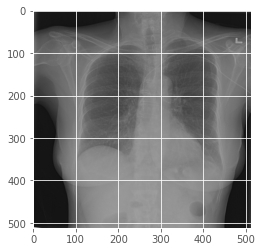

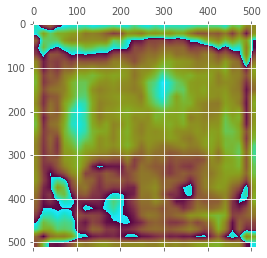

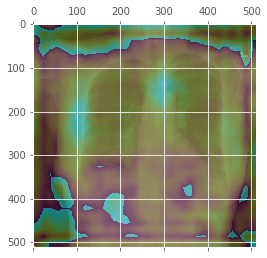

image2: Normal


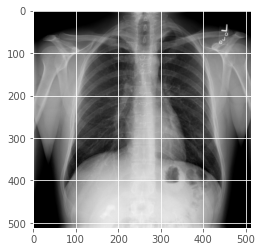

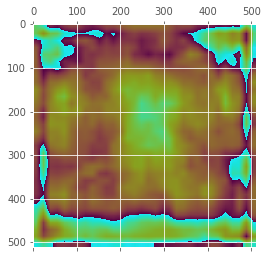

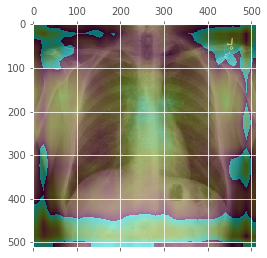

image2: Covid


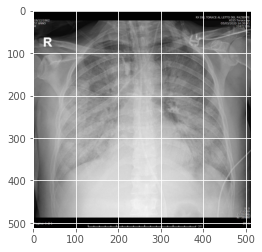

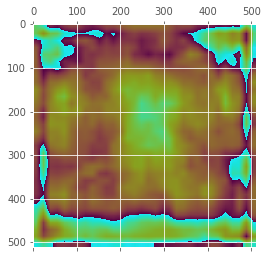

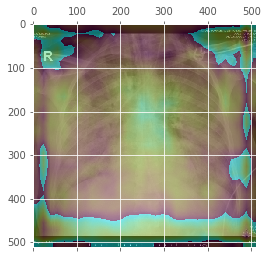

image2: Covid


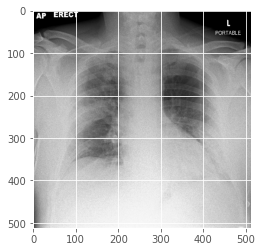

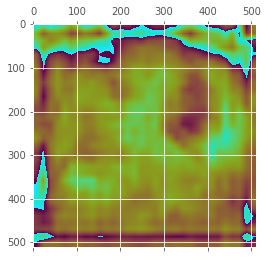

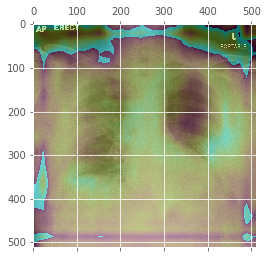

In [38]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [39]:
#declare a Variable named layer

Layer_to_examine='block9_sepconv1'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


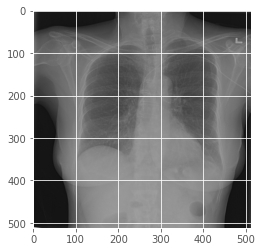

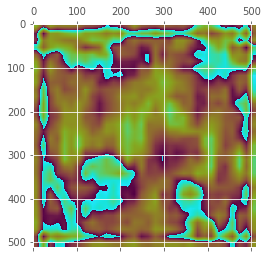

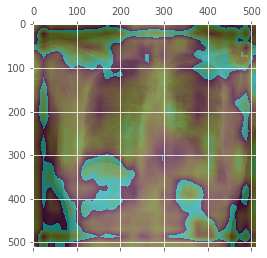

image2: Normal


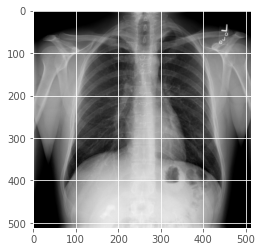

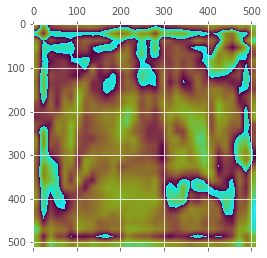

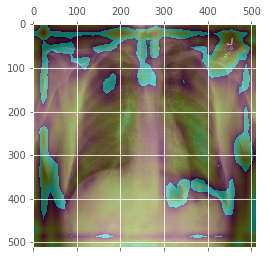

image2: Covid


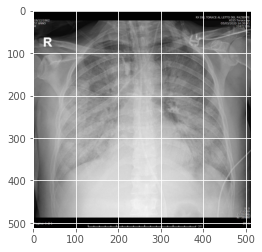

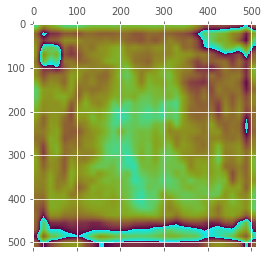

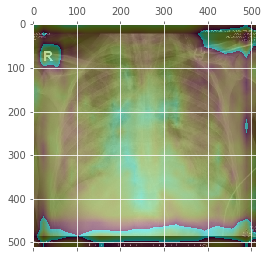

image2: Covid


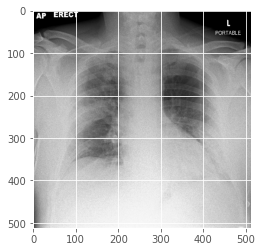

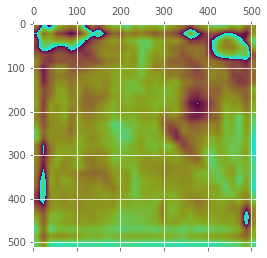

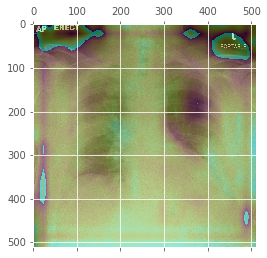

In [40]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [41]:
## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, 'block8_sepconv1') 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, 'block8_sepconv1') 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, 'block8_sepconv1') 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, 'block8_sepconv1') 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg')
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


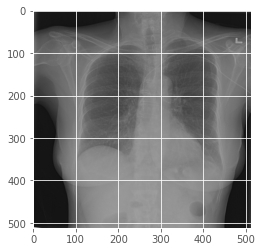

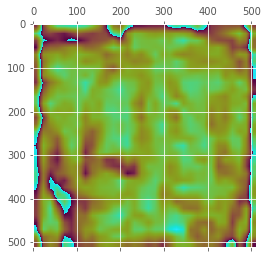

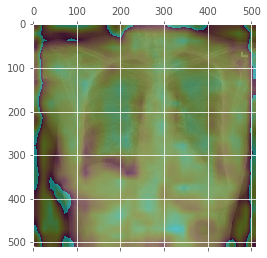

image2: Normal


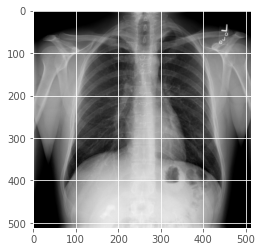

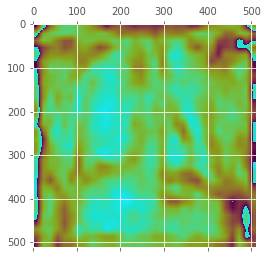

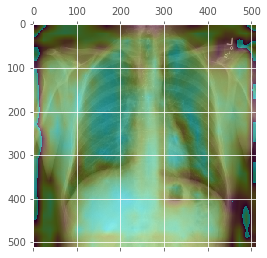

image2: Covid


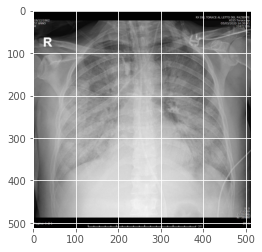

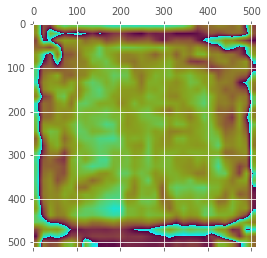

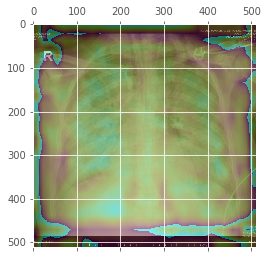

image2: Covid


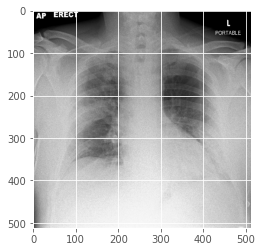

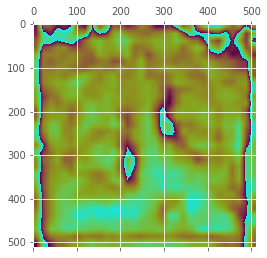

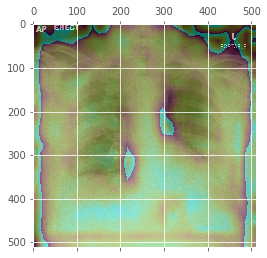

In [42]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [43]:
#declare a Variable named layer

Layer_to_examine='block7_sepconv1'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


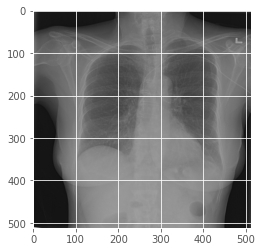

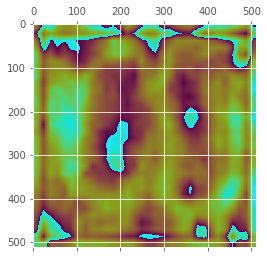

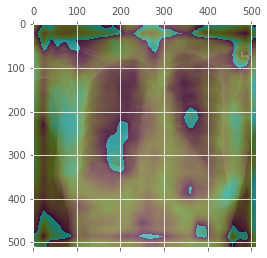

image2: Normal


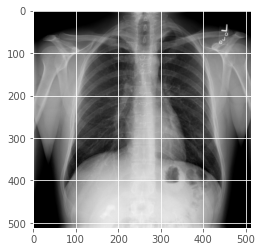

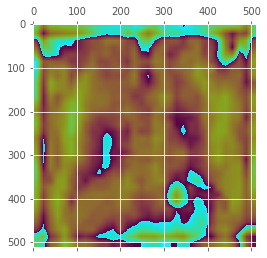

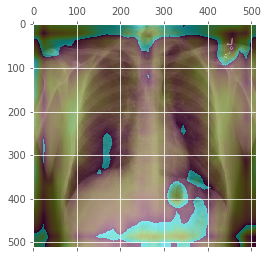

image2: Covid


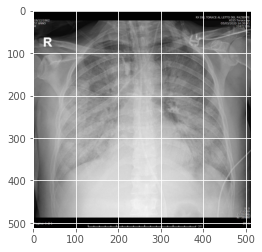

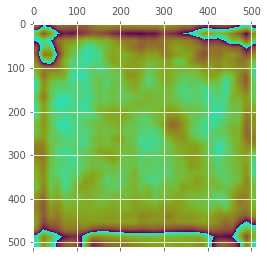

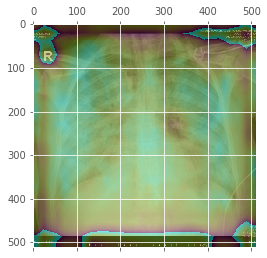

image2: Covid


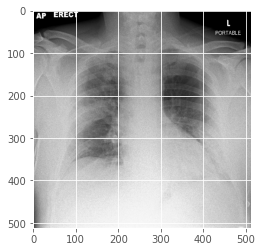

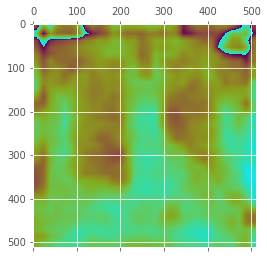

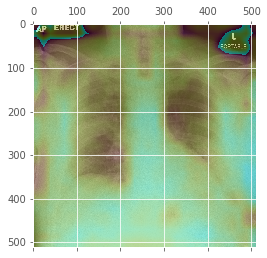

In [44]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [45]:
#declare a Variable named layer

Layer_to_examine='block6_sepconv1'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


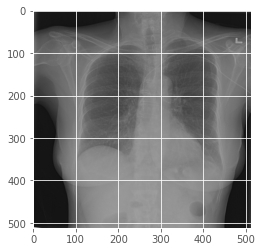

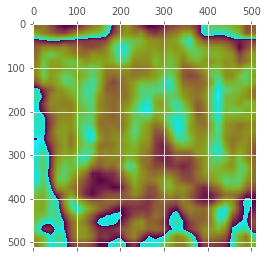

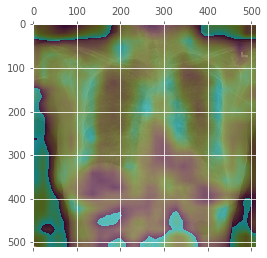

image2: Normal


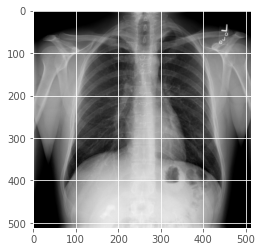

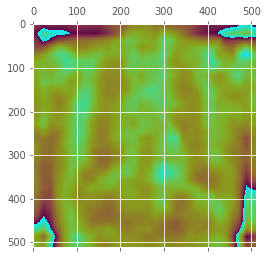

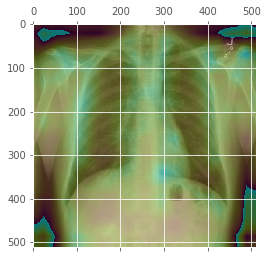

image2: Covid


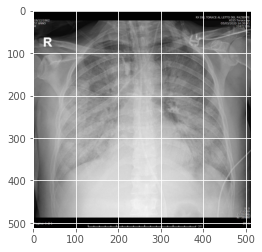

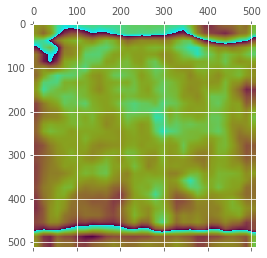

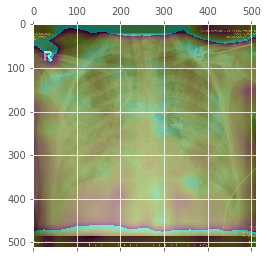

image2: Covid


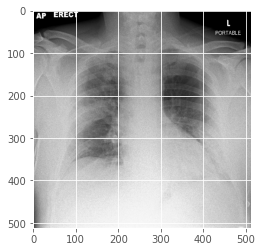

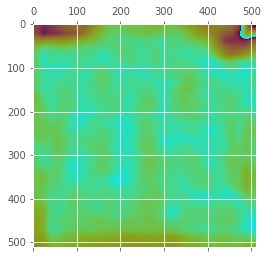

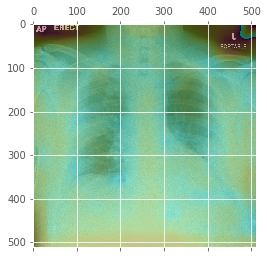

In [46]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [47]:
#declare a Variable named layer

Layer_to_examine='block5_sepconv1'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


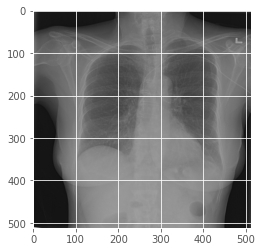

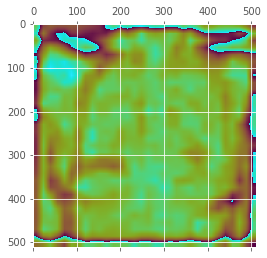

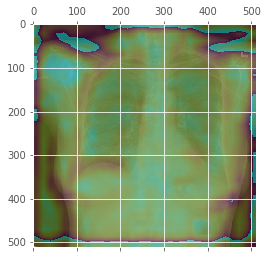

image2: Normal


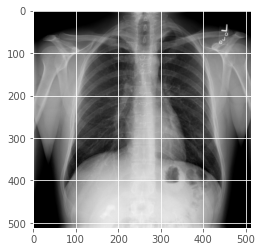

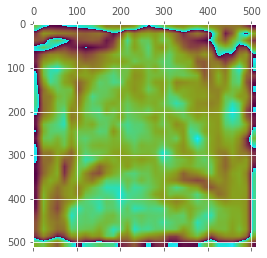

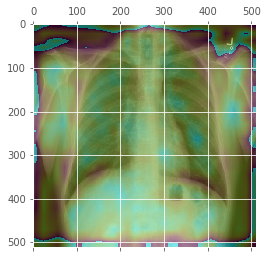

image2: Covid


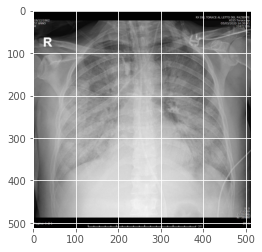

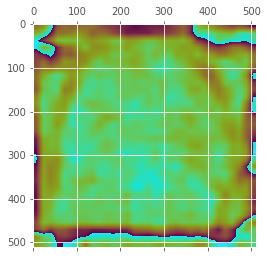

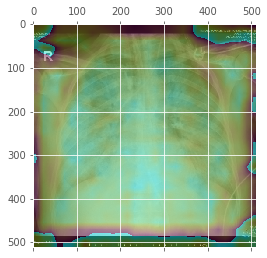

image2: Covid


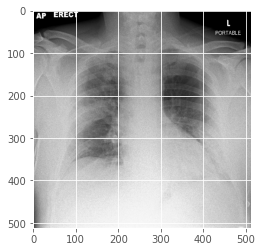

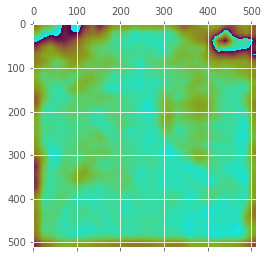

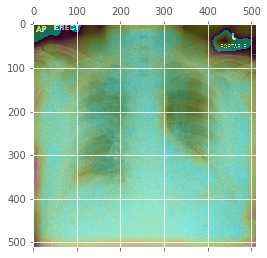

In [48]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [49]:
#declare a Variable named layer

Layer_to_examine='block4_sepconv1'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


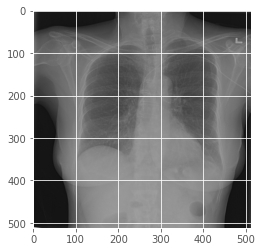

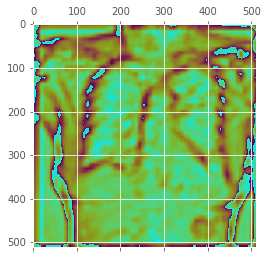

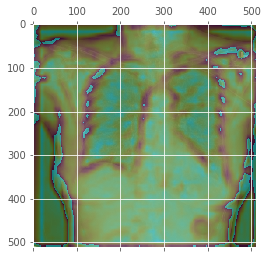

image2: Normal


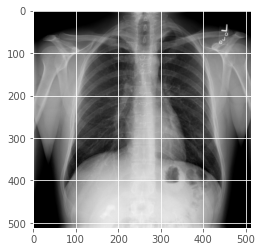

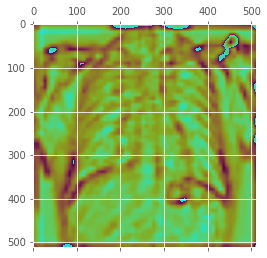

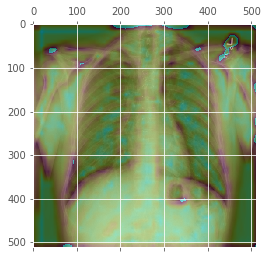

image2: Covid


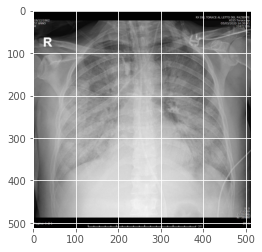

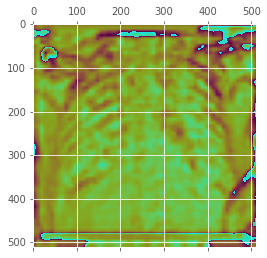

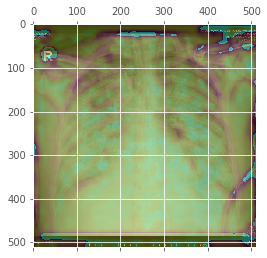

image2: Covid


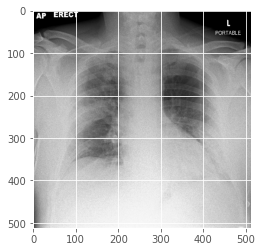

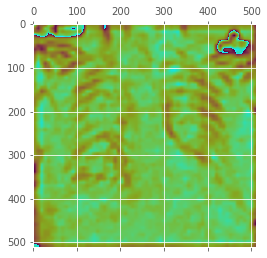

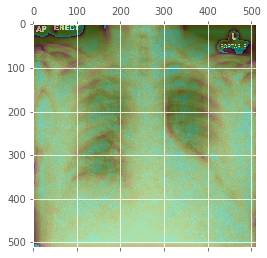

In [50]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [51]:
#declare a Variable named layer

Layer_to_examine='block3_sepconv1'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


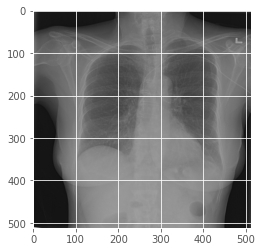

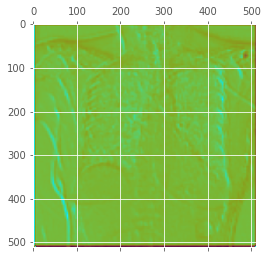

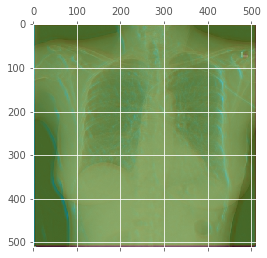

image2: Normal


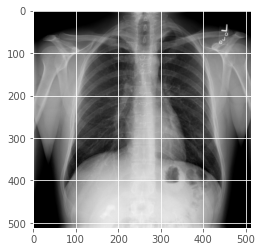

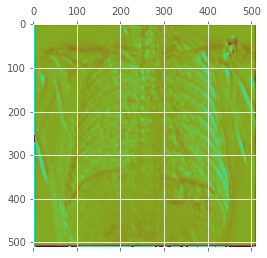

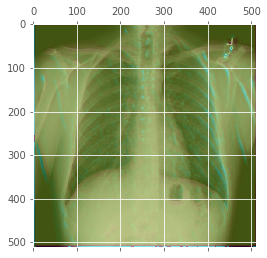

image2: Covid


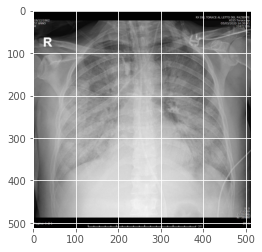

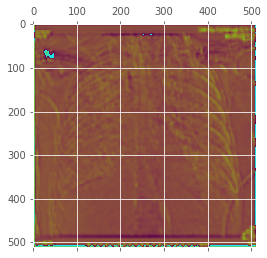

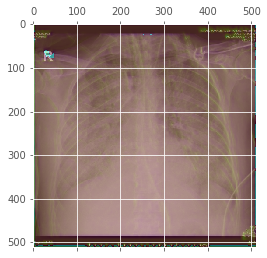

image2: Covid


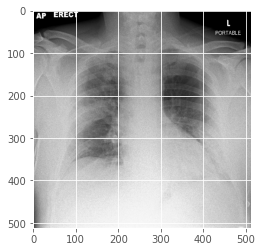

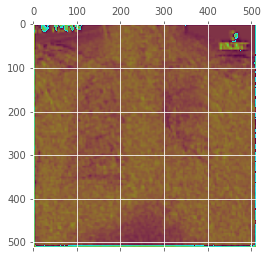

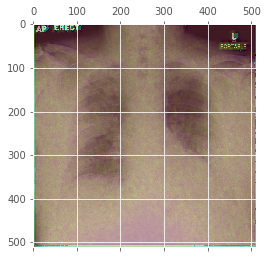

In [52]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [53]:
#declare a Variable named layer

Layer_to_examine='block2_sepconv1'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


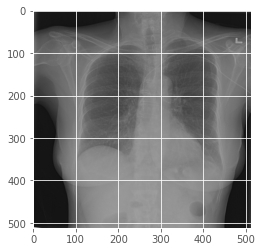

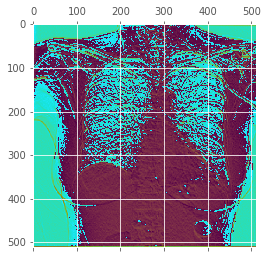

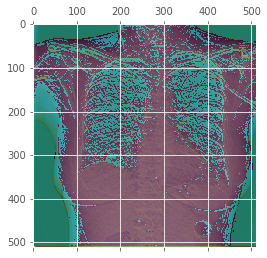

image2: Normal


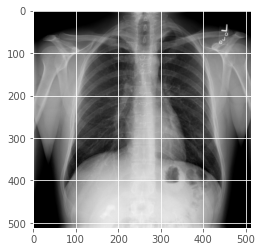

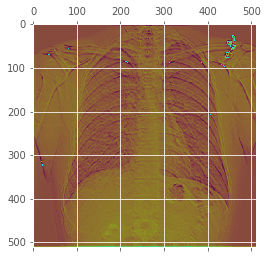

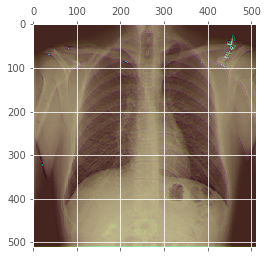

image2: Covid


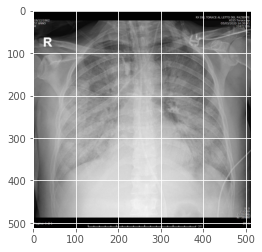

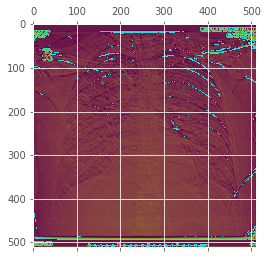

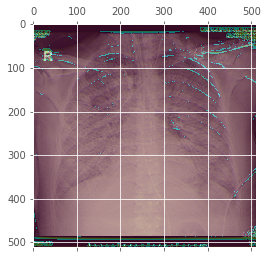

image2: Covid


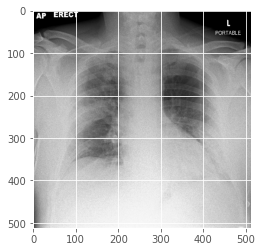

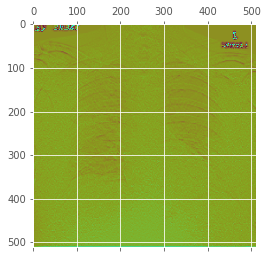

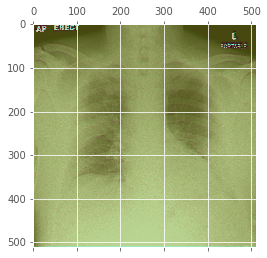

In [54]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [55]:
#declare a Variable named layer

Layer_to_examine='block14_sepconv1'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


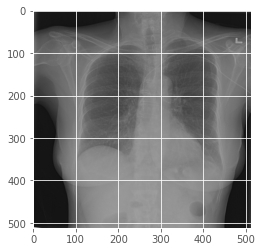

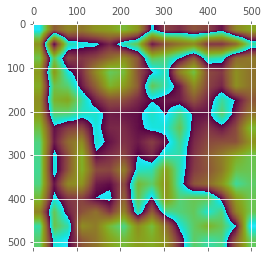

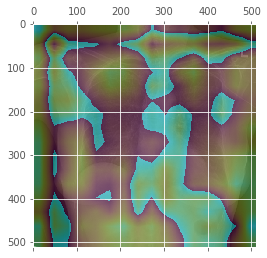

image2: Normal


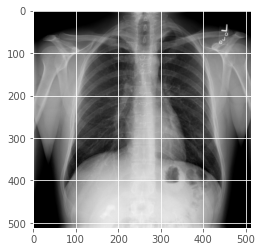

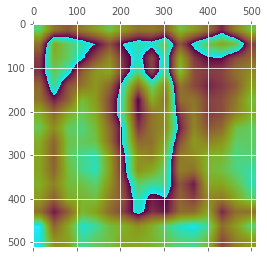

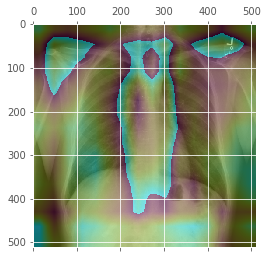

image2: Covid


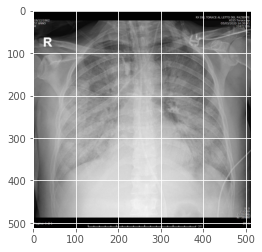

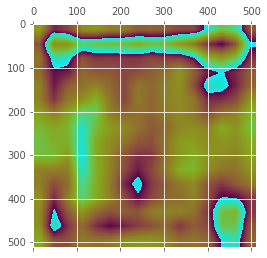

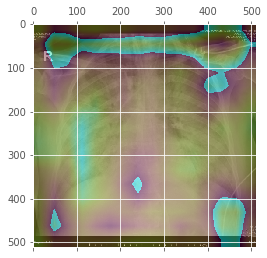

image2: Covid


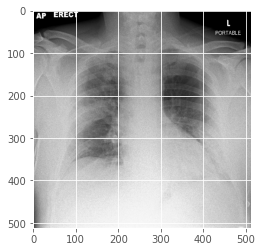

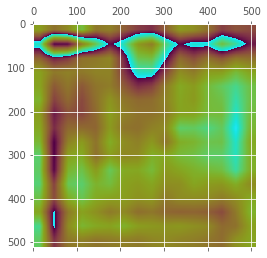

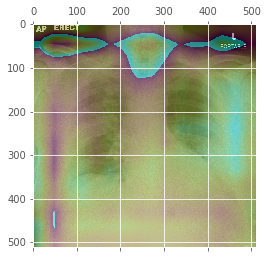

In [56]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [57]:
## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, 'block14_sepconv1_bn') 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, 'block14_sepconv1_bn') 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, 'block14_sepconv1_bn') 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, 'block14_sepconv1_bn') 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


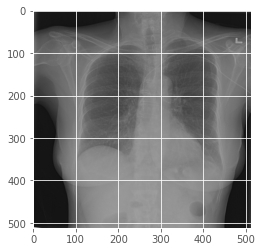

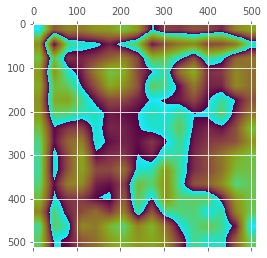

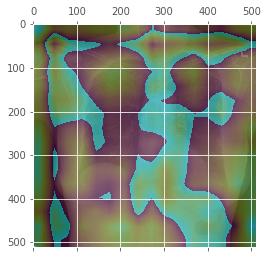

image2: Normal


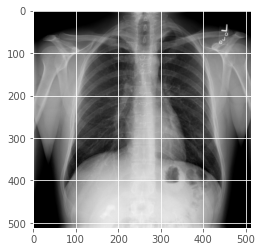

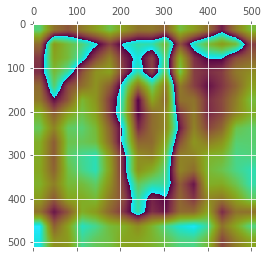

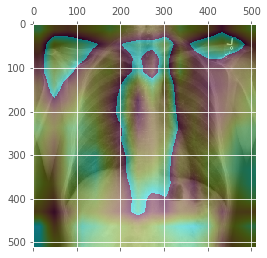

image2: Covid


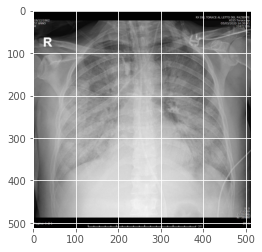

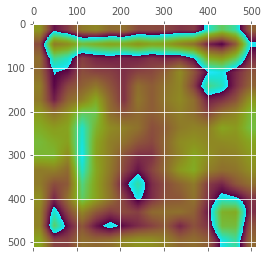

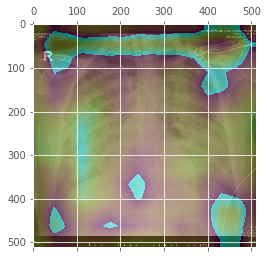

image2: Covid


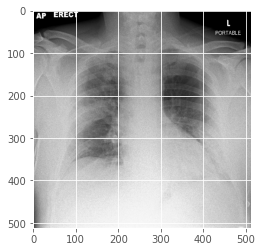

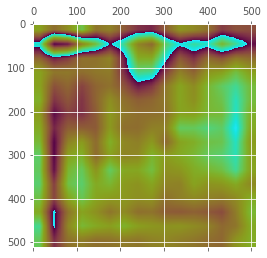

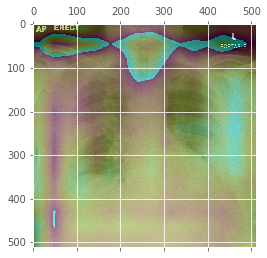

In [58]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [59]:
## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, 'block14_sepconv1_act') 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, 'block14_sepconv1_act') 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, 'block14_sepconv1_act') 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, 'block14_sepconv1_act') 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


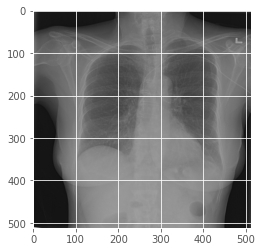

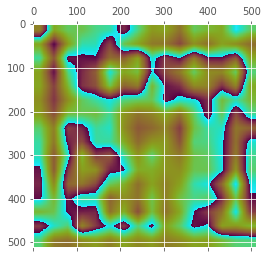

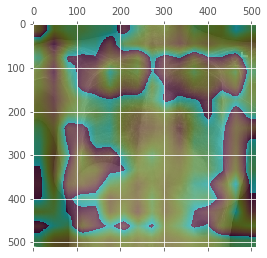

image2: Normal


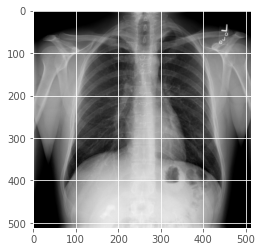

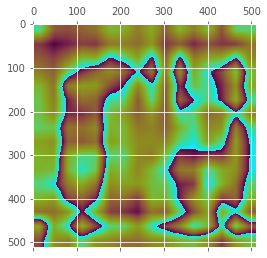

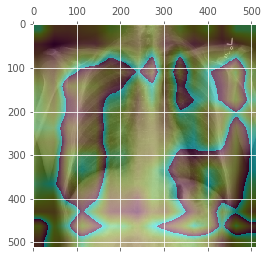

image2: Covid


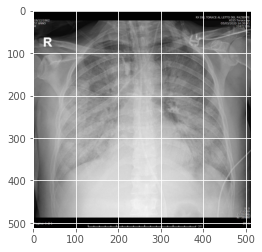

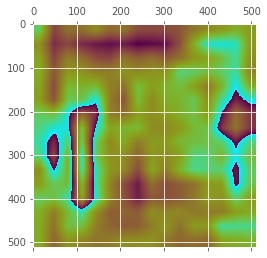

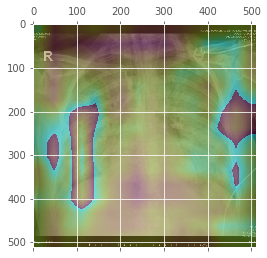

image2: Covid


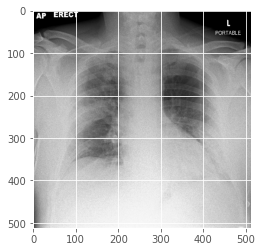

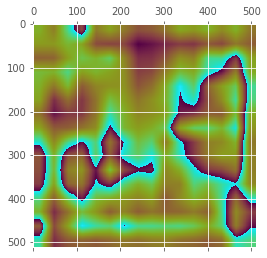

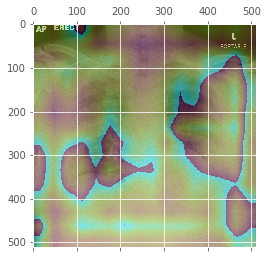

In [60]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [61]:
#declare a Variable named layer

Layer_to_examine='block14_sepconv2'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


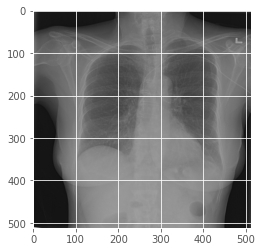

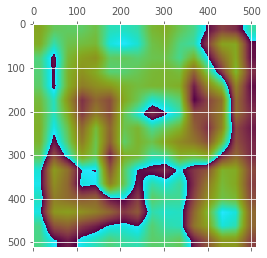

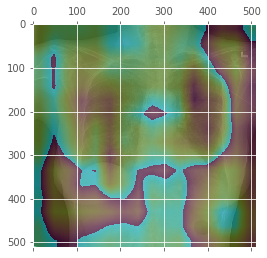

image2: Normal


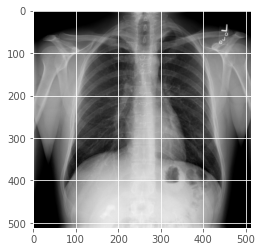

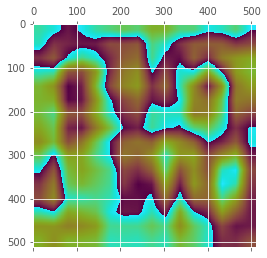

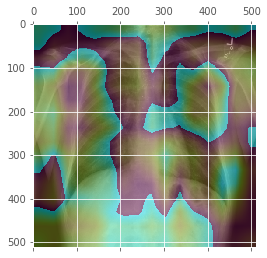

image2: Covid


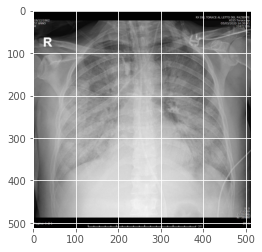

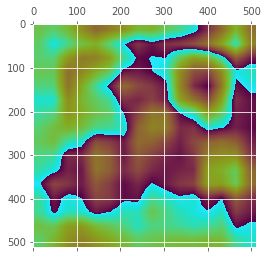

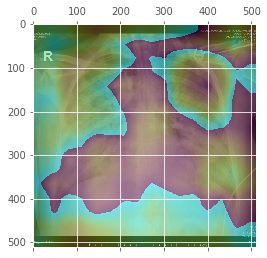

image2: Covid


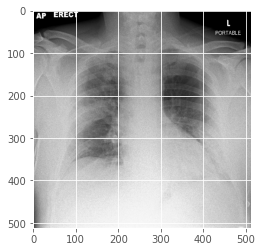

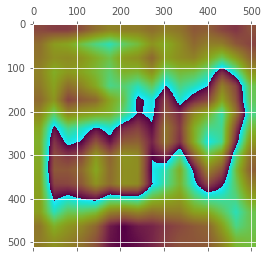

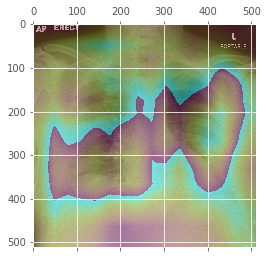

In [62]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [63]:
#declare a Variable named layer

Layer_to_examine='block14_sepconv2_bn'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


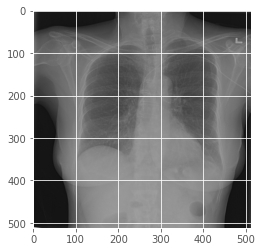

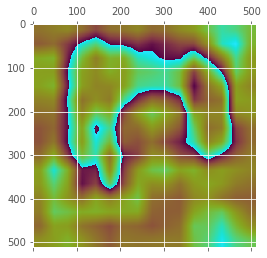

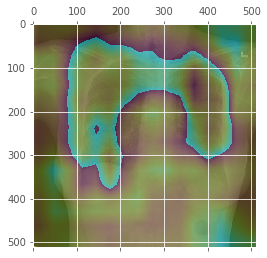

image2: Normal


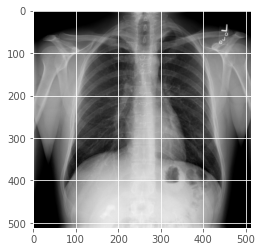

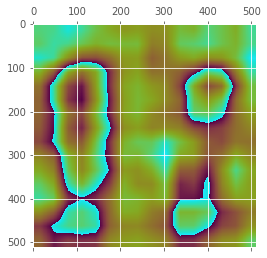

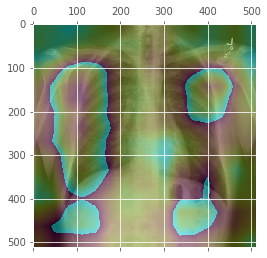

image2: Covid


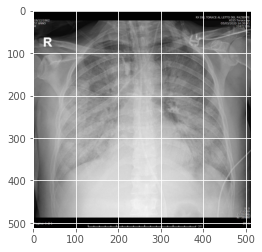

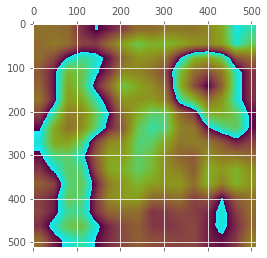

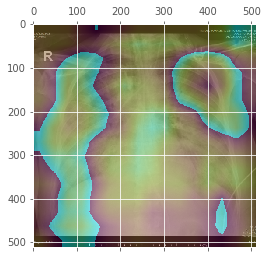

image2: Covid


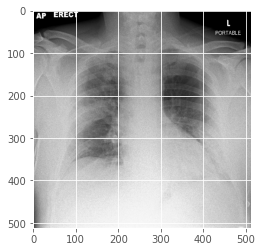

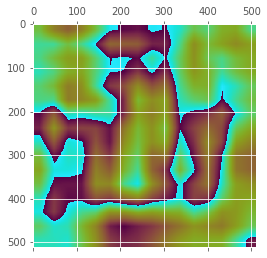

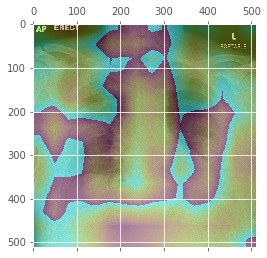

In [64]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [65]:
#declare a Variable named layer

Layer_to_examine='block14_sepconv2_act'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


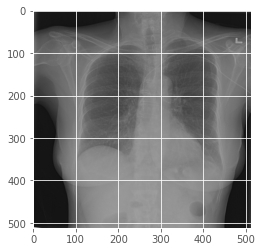

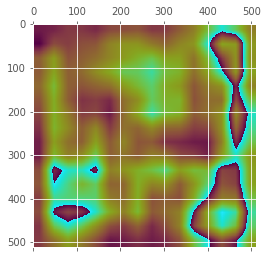

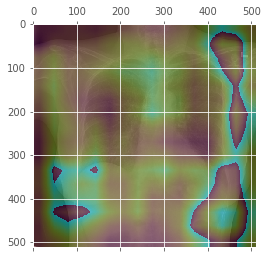

image2: Normal


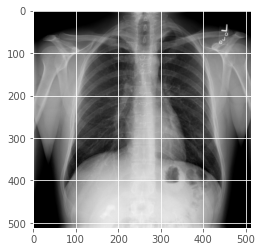

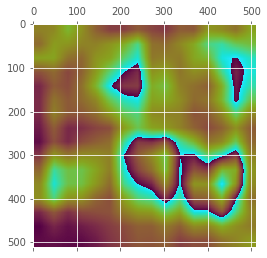

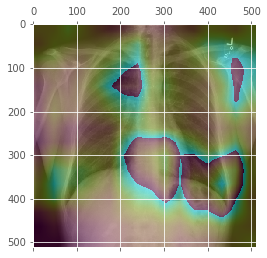

image2: Covid


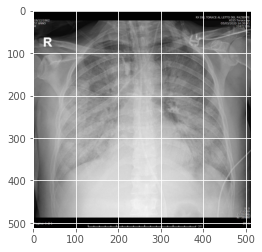

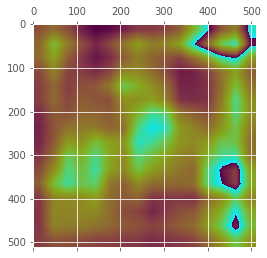

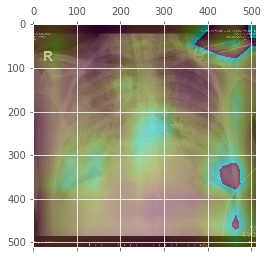

image2: Covid


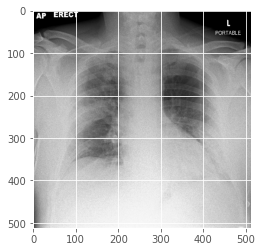

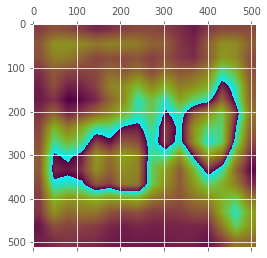

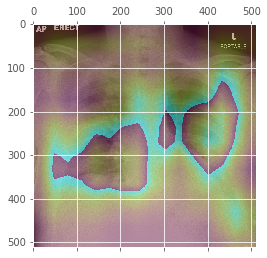

In [66]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [67]:
## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, 'block13_sepconv2') 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, 'block13_sepconv2') 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, 'block13_sepconv2') 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, 'block13_sepconv2') 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


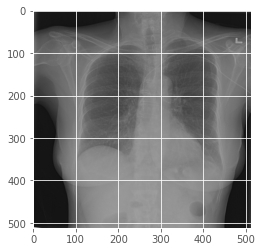

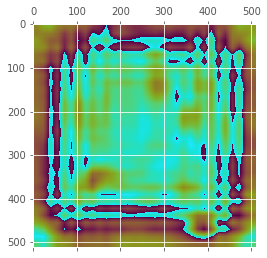

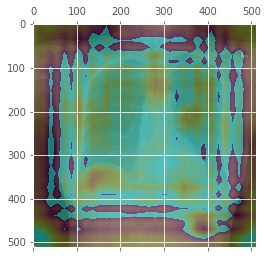

image2: Normal


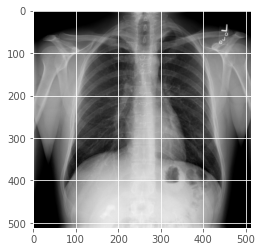

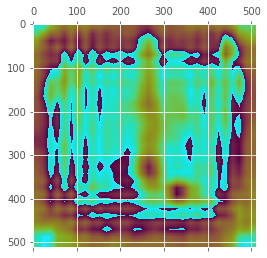

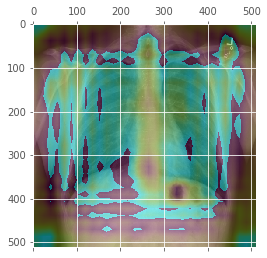

image2: Covid


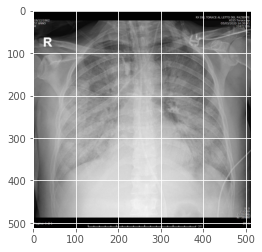

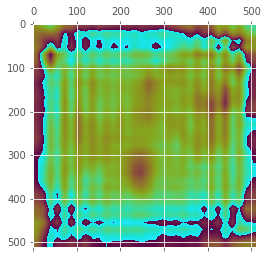

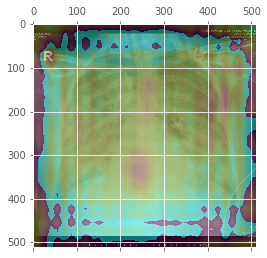

image2: Covid


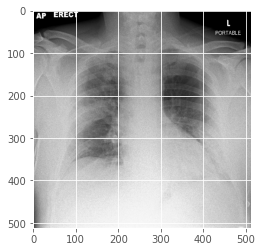

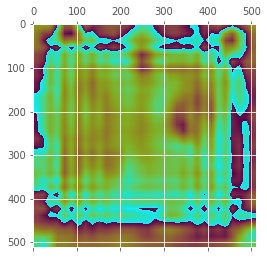

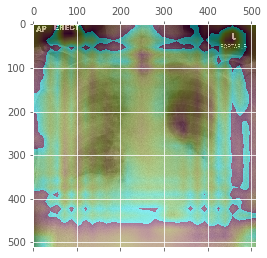

In [68]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [69]:
#declare a Variable named layer

Layer_to_examine='block12_sepconv2'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


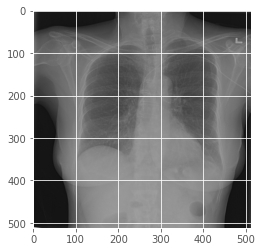

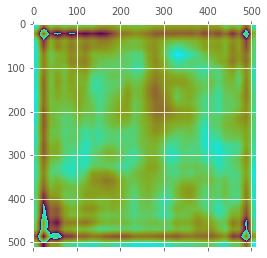

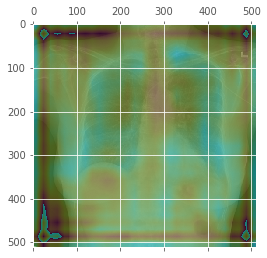

image2: Normal


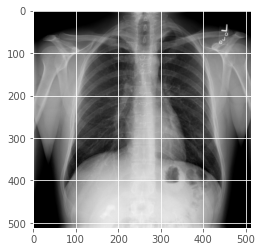

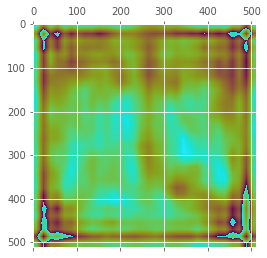

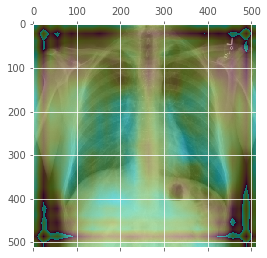

image2: Covid


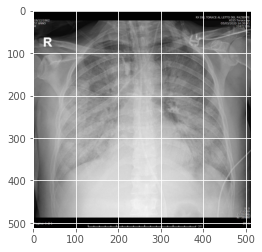

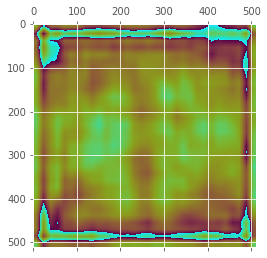

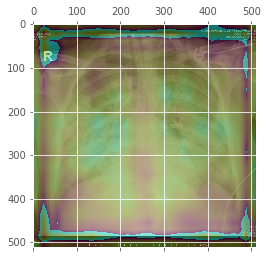

image2: Covid


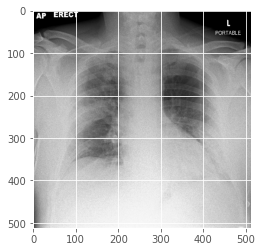

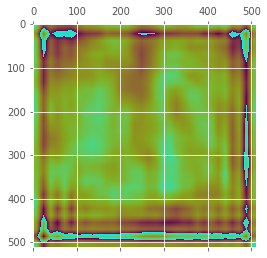

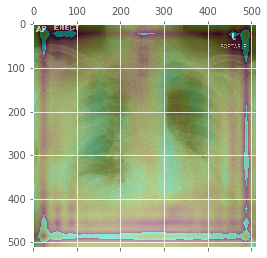

In [70]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [71]:
#declare a Variable named layer

Layer_to_examine='block11_sepconv2'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


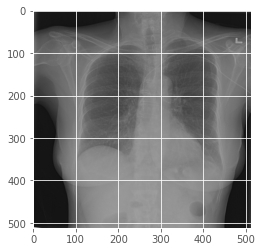

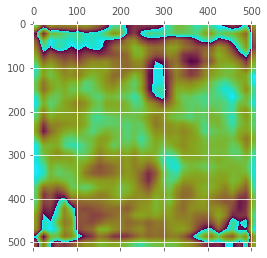

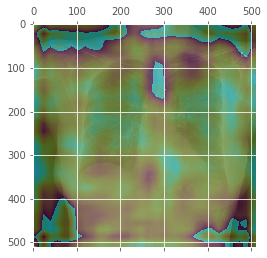

image2: Normal


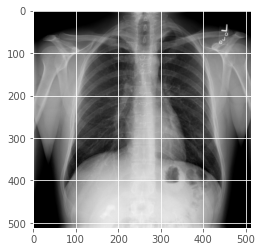

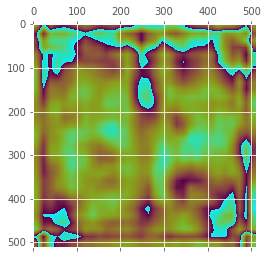

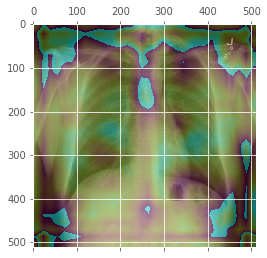

image2: Covid


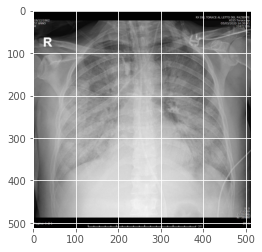

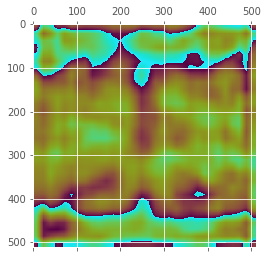

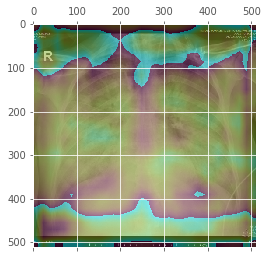

image2: Covid


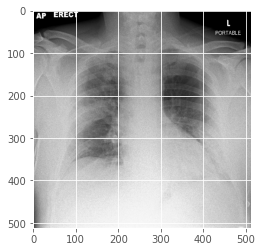

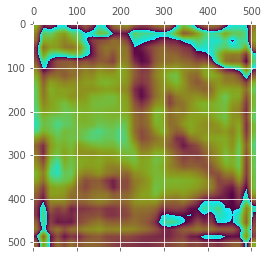

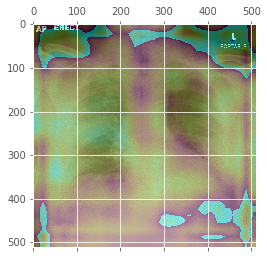

In [72]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [73]:
#declare a Variable named layer

Layer_to_examine='block10_sepconv2'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


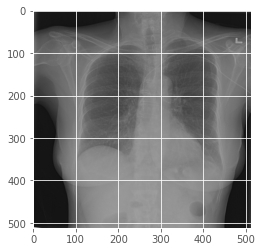

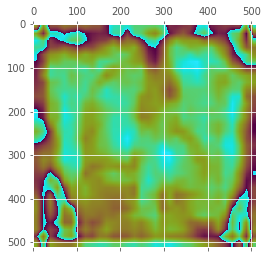

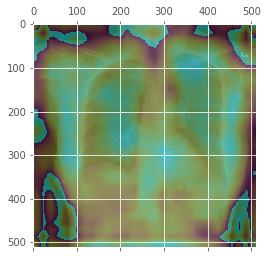

image2: Normal


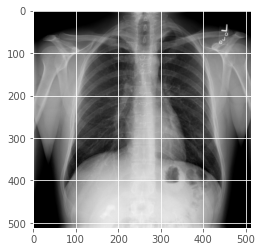

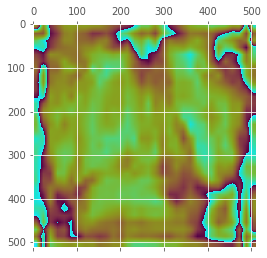

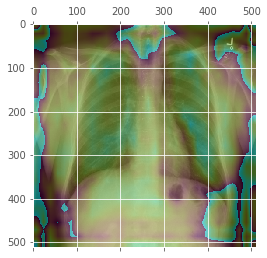

image2: Covid


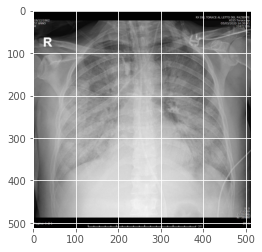

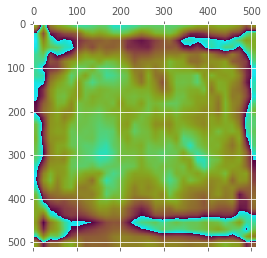

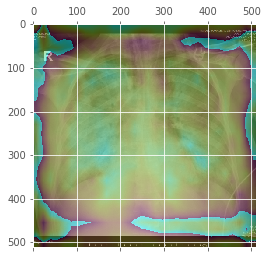

image2: Covid


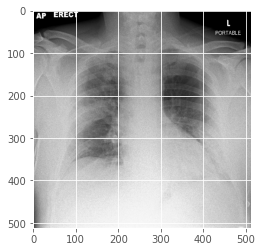

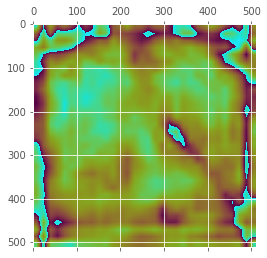

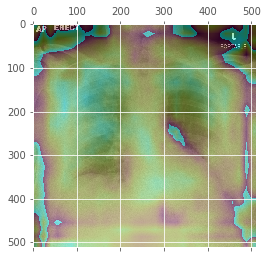

In [74]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [75]:
#declare a Variable named layer

Layer_to_examine='block9_sepconv2'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


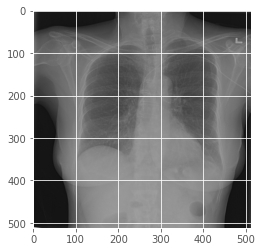

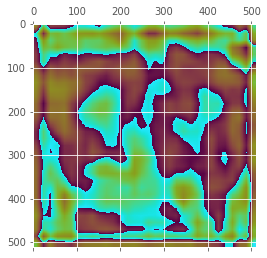

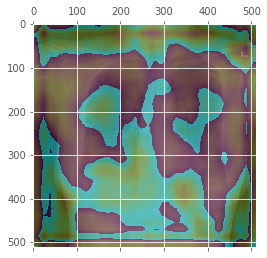

image2: Normal


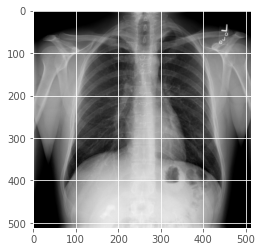

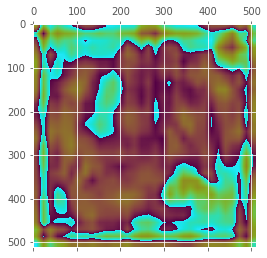

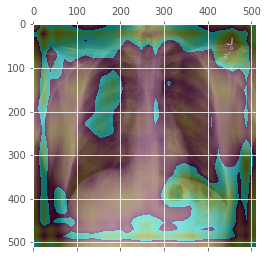

image2: Covid


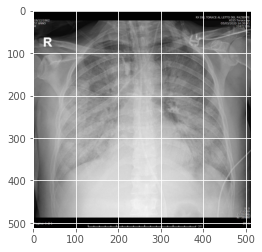

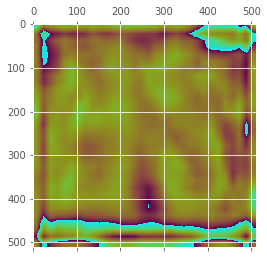

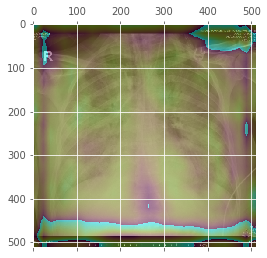

image2: Covid


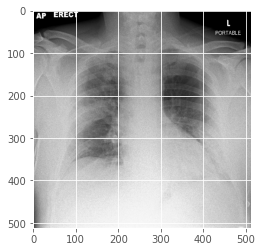

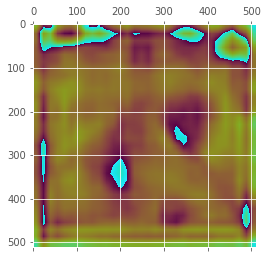

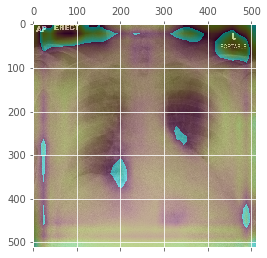

In [76]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [77]:
#declare a Variable named layer

Layer_to_examine='block8_sepconv2'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


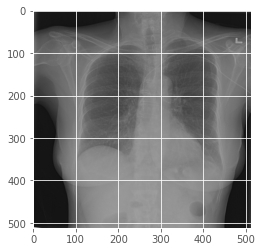

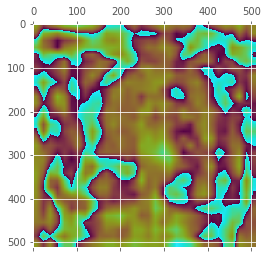

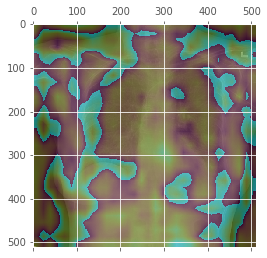

image2: Normal


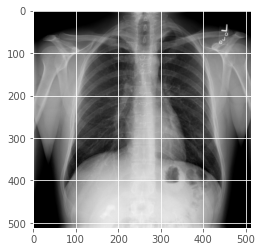

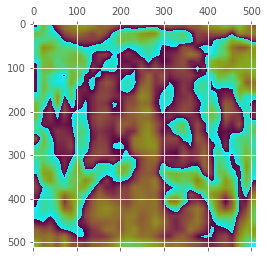

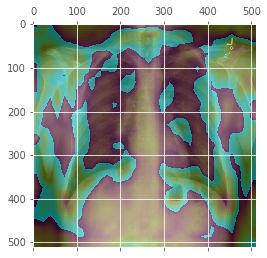

image2: Covid


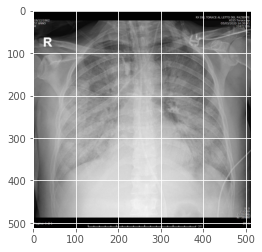

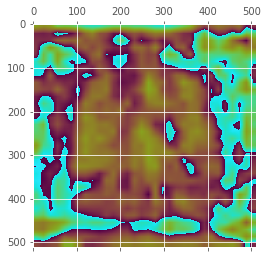

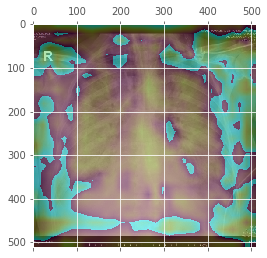

image2: Covid


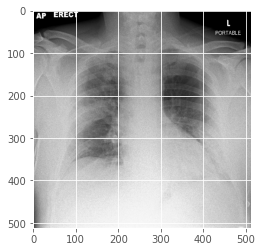

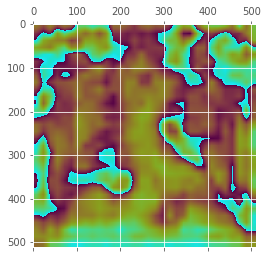

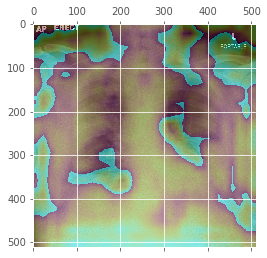

In [78]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [79]:
#declare a Variable named layer

Layer_to_examine='block14_sepconv2'


## Do not change upto certain portion; then please edit block or layer
image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
image1 = image1.astype('float32') / 255
image1 = np.expand_dims(image1, axis=0)

preds = model.predict(image1) 
i1 = np.argmax(preds[0])
print(i1)

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
image2 = image2.astype('float32') / 255
image2 = np.expand_dims(image2, axis=0)

preds = model.predict(image2) 
i2 = np.argmax(preds[0])
print(i2)

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
image3 = image3.astype('float32') / 255
image3 = np.expand_dims(image3, axis=0)

preds = model.predict(image3) 
i3 = np.argmax(preds[0])
print(i3)

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
image4 = image4.astype('float32') / 255
image4 = np.expand_dims(image4, axis=0)

preds = model.predict(image4) 
i4 = np.argmax(preds[0])
print(i4)

# Do not change opto this portion

##For my reference change block only

# Image 1
icam1 = GradCAM(model, i1, Layer_to_examine) 
heatmap1 = icam1.compute_heatmap(image1)
heatmap1 = cv2.resize(heatmap1, (512, 512))

image1 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00000080_005.png')
image1 = cv2.resize(image1, (512, 512))
print(heatmap1.shape, image1.shape)

(heatmap1, output1) = icam1.overlay_heatmap(heatmap1, image1, alpha=0.5)


# image 2
icam2 = GradCAM(model, i2, Layer_to_examine) 
heatmap2 = icam2.compute_heatmap(image2)
heatmap2 = cv2.resize(heatmap2, (512, 512))

image2 = cv2.imread('/content/Covid19Detection/DATASET/0-NORMAL/00001943_000.png')
image2 = cv2.resize(image2, (512, 512))
print(heatmap2.shape, image2.shape)

(heatmap2, output2) = icam2.overlay_heatmap(heatmap2, image2, alpha=0.5)

# Image 3
icam3 = GradCAM(model, i3, Layer_to_examine) 
heatmap3 = icam3.compute_heatmap(image3)
heatmap3 = cv2.resize(heatmap3, (512, 512))

image3 = cv2.imread('/content/Covid19Detection/DATASET/1-COVID/31BA3780-2323-493F-8AED-62081B9C383B.jpeg')
image3 = cv2.resize(image3, (512, 512))
print(heatmap3.shape, image3.shape)

(heatmap3, output3) = icam3.overlay_heatmap(heatmap3, image3, alpha=0.5)


# Image 4
icam4 = GradCAM(model, i4, Layer_to_examine) 
heatmap4 = icam4.compute_heatmap(image4)
heatmap4 = cv2.resize(heatmap4, (512, 512))

image4 = cv2.imread("/content/Covid19Detection/DATASET/1-COVID/covid-19-pneumonia-24.jpg")
image4 = cv2.resize(image4, (512, 512))
print(heatmap4.shape, image4.shape)

(heatmap4, output4) = icam4.overlay_heatmap(heatmap4, image4, alpha=0.5)


1
0
1
1
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)
(512, 512) (512, 512, 3)


image1:Normal


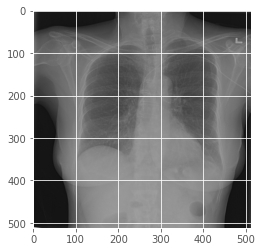

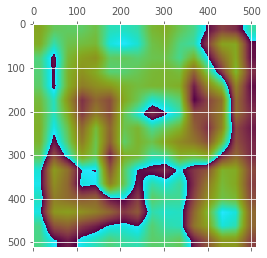

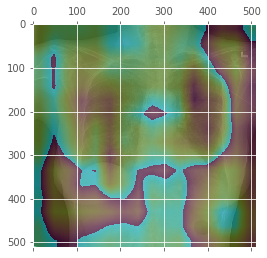

image2: Normal


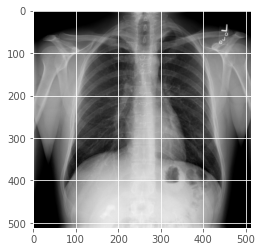

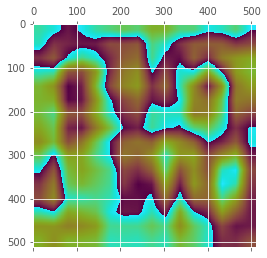

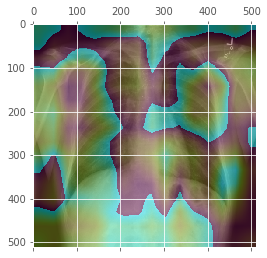

image2: Covid


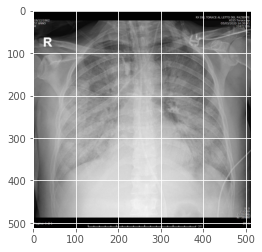

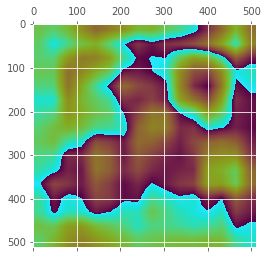

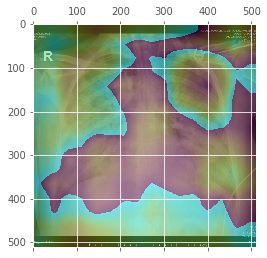

image2: Covid


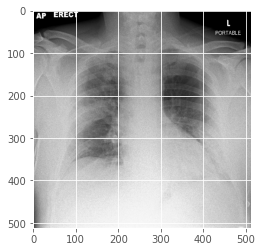

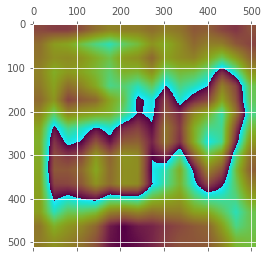

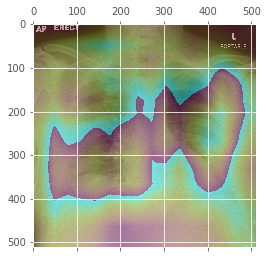

In [80]:
#image1
print("image1:Normal")
plt.imshow(image1)
plt.show()
plt.matshow(heatmap1)
plt.show()
plt.matshow(output1) 
plt.show()

#image 2
print("image2: Normal")
plt.imshow(image2)
plt.show()
plt.matshow(heatmap2)
plt.show()
plt.matshow(output2) 
plt.show()

print("image2: Covid")
#image 3
plt.imshow(image3)
plt.show()
plt.matshow(heatmap3)
plt.show()
plt.matshow(output3) 
plt.show()

print("image2: Covid")
#image 4
plt.imshow(image4)
plt.show()
plt.matshow(heatmap4)
plt.show()
plt.matshow(output4) 
plt.show()



In [81]:
!nvidia-smi

Sat Jul 10 16:15:11 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   62C    P0    46W / 250W |   9757MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [82]:
pip install scikit-plot

In [83]:

import matplotlib.pyplot as plt

In [84]:
# Make predictions on the testing set
print("[INFO] evaluating network...")
y_probas = model.predict(testX, batch_size=batch_size)
print('Number of test scans: ', len(testX))
print('Predicted class probabilities:')
print()

for n in range(len(y_probas)):
    my_formatted_list = ['%.2f' % elem for elem in y_probas[n]]
    print(f'{n}:  ', *my_formatted_list)



[INFO] evaluating network...
Number of test scans:  400
Predicted class probabilities:

0:   1.00 0.00
1:   1.00 0.00
2:   0.00 1.00
3:   0.42 0.48
4:   0.00 1.00
5:   0.00 1.00
6:   0.00 1.00
7:   0.00 1.00
8:   0.00 1.00
9:   0.21 0.75
10:   1.00 0.00
11:   1.00 0.00
12:   0.00 1.00
13:   0.00 1.00
14:   1.00 0.00
15:   1.00 0.00
16:   0.00 1.00
17:   0.00 1.00
18:   1.00 0.00
19:   0.00 1.00
20:   0.00 1.00
21:   0.00 1.00
22:   0.01 0.99
23:   0.00 1.00
24:   1.00 0.00
25:   1.00 0.00
26:   1.00 0.00
27:   0.00 1.00
28:   1.00 0.00
29:   0.00 1.00
30:   1.00 0.00
31:   1.00 0.00
32:   1.00 0.00
33:   0.00 1.00
34:   0.00 1.00
35:   0.00 1.00
36:   0.00 1.00
37:   1.00 0.00
38:   1.00 0.00
39:   1.00 0.00
40:   0.53 0.46
41:   0.00 1.00
42:   0.00 1.00
43:   0.90 0.10
44:   0.00 1.00
45:   1.00 0.00
46:   0.00 1.00
47:   0.00 1.00
48:   0.00 1.00
49:   0.03 0.96
50:   0.00 1.00
51:   1.00 0.00
52:   1.00 0.00
53:   1.00 0.00
54:   1.00 0.00
55:   0.07 0.93
56:   0.01 1.00
57:   0.00

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; This will be removed in v0.5.0. Please use scikitplot.metrics.plot_roc instead.
  warnings.warn(msg, category=FutureWarning)


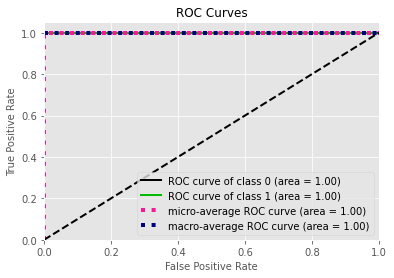

In [85]:
import scikitplot as skplt
import matplotlib.pyplot as plt

skplt.metrics.plot_roc_curve(predIdxs, y_probas)
plt.show()

Text(0.5, 1.0, 'Confusion Matrix for Xception')

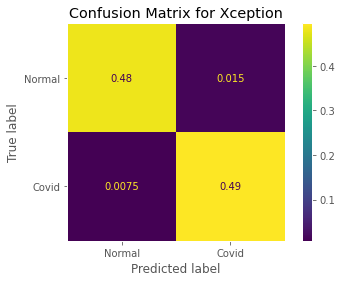

In [86]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm = confusion_matrix(trueIdxs, predIdxs, normalize='all')
cmd = ConfusionMatrixDisplay(cm, display_labels=['Normal','Covid'])
cmd.plot()
plt.grid(None)
plt.title("Confusion Matrix for Xception")
